# Object Detection
---

В рамках данного задания вы подробно разберете типовую архитектуру для решения задачи детекции, а также обучите модель для решения задачи детектирования шаров

In [1]:
!pip install mean_average_precision

In [2]:
import os
import sys
import cv2
import json
import matplotlib.pyplot as plt

import numpy as np
import torch
from torch import nn
from torchvision.transforms.functional import to_tensor, normalize
from torchvision.ops import nms
import seaborn as sns

import torch.utils.data
from PIL import Image

from mean_average_precision import MetricBuilder
import gc
import tqdm

from torchvision import transforms
from torch.utils.data import DataLoader
import warnings

warnings.filterwarnings("ignore")


%reload_ext autoreload

In [3]:
!gdown "1vEA1yc7eri3YpXE9YqCCqxwJh3_UeKjR"

Downloading...
From (original): https://drive.google.com/uc?id=1vEA1yc7eri3YpXE9YqCCqxwJh3_UeKjR
From (redirected): https://drive.google.com/uc?id=1vEA1yc7eri3YpXE9YqCCqxwJh3_UeKjR&confirm=t&uuid=b5a03e73-9446-4a7b-8809-d1e4f0f1540c
To: /kaggle/working/dl-6-content.zip
100%|██████████████████████████████████████| 1.08G/1.08G [00:13<00:00, 77.8MB/s]


In [4]:
!unzip dl-6-content.zip

Archive:  dl-6-content.zip
   creating: dl-6-content/
  inflating: __MACOSX/._dl-6-content  
  inflating: dl-6-content/.DS_Store  
  inflating: __MACOSX/dl-6-content/._.DS_Store  
   creating: dl-6-content/oi5_ball/
  inflating: __MACOSX/dl-6-content/._oi5_ball  
   creating: dl-6-content/images/
  inflating: dl-6-content/oi5_ball_retinanet_ep=10.pt  
  inflating: __MACOSX/dl-6-content/._oi5_ball_retinanet_ep=10.pt  
  inflating: dl-6-content/oi5_ball_filename_to_bbox_val.json  
  inflating: __MACOSX/dl-6-content/._oi5_ball_filename_to_bbox_val.json  
  inflating: dl-6-content/FIXED_coco_resnet_50_map_0_335_state_dict.pt  
  inflating: __MACOSX/dl-6-content/._FIXED_coco_resnet_50_map_0_335_state_dict.pt  
  inflating: dl-6-content/coco_id_to_name.json  
  inflating: __MACOSX/dl-6-content/._coco_id_to_name.json  
  inflating: dl-6-content/oi5_ball_filename_to_bbox_train.json  
  inflating: __MACOSX/dl-6-content/._oi5_ball_filename_to_bbox_train.json  
  inflating: dl-6-content/oi5_ball/



## 1. RetinaNet (2 балла)

Рассмотрим реализацию архитектуры RetinaNet для детектирования объектов за один проход.


#### Материалы для чтения:
1. Оригинальная статья про RetinaNet: [Focal Loss for Dense Object Detection](https://arxiv.org/pdf/1708.02002.pdf)
2. Статья о подходе FPN: [Feature Pyramid Networks for Object Detection](https://arxiv.org/pdf/1612.03144.pdf)
3. Пост [RetinaNet Explained and Demystified](https://blog.zenggyu.com/en/post/2018-12-05/retinanet-explained-and-demystified/)


#### Ключевые особенности RetinaNet:
* Использование специальной функции потерь (*Focal Loss*)
  * для борьбы с дисбалансом классов при обучении (обычно "объектов" на изображении меньше, чем "фона")
* Комбинирование признаков с разных глубин сети  (*Features Pyramid*)
  * для "уравнивания" семантической силы нейронов на разных масштабах

---

### 1.0 Посмотрим на данные

Функции для визуализации

In [ ]:
def show_image(image, figsize=(10, 10)):
    plt.figure(figsize=figsize)
    plt.imshow(image)
    plt.axis("off")
    plt.show()


def draw_predictions(image, bboxes, scores, classes, class_to_label_map=None, threshold=0.5):
    palette = sns.color_palette(None, len(class_to_label_map))
    image_with_predictions = image.copy()

    for bbox, score, class_int in zip(bboxes, scores, classes):
        if score < threshold:
            continue

        x1, y1, x2, y2 = bbox.numpy().astype(np.int32)
        label = class_to_label_map[class_int.item()]
        color = palette[class_int.item()]

        cv2.rectangle(image_with_predictions, (x1, y1), (x2, y2), np.array(color) * 255, 2)
        if class_to_label_map is not None:
            cv2.putText(image_with_predictions, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.7, np.array(color) * 255, 2)


    return image_with_predictions

Подгрузим тестовое изображение и сделаем из него батч размера 1. Это пригодится нам для демонстрации работы отдельных компонентов модели.

In [ ]:
def make_tensor(image, device=None):
    tensor = to_tensor(image).unsqueeze(0)
    tensor = normalize(tensor,
                       mean=(0.485, 0.456, 0.406),
                       std=(0.229, 0.224, 0.225))
    if device:
        tensor = tensor.to(device)
    return tensor

Image shape (540, 800, 3)
Tensor size torch.Size([1, 3, 540, 800])


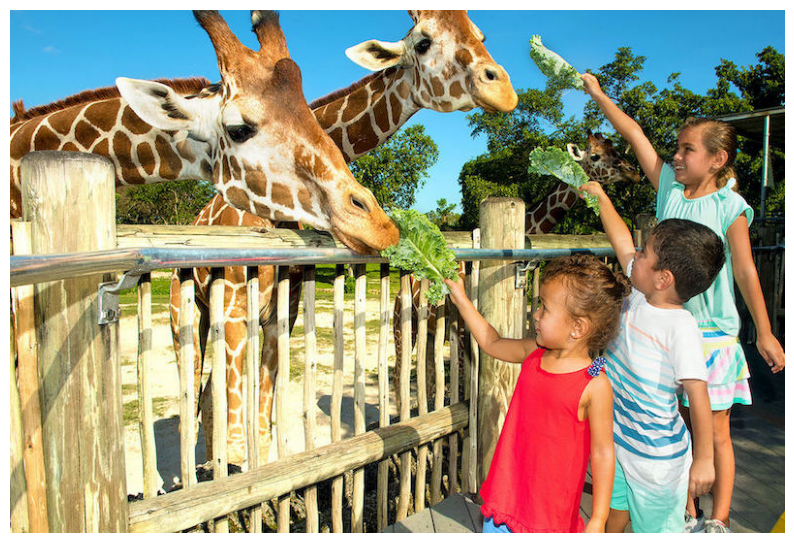

In [ ]:
image_example = cv2.imread("/content/dl-6-content/images/zoo.jpg")


image_example = cv2.cvtColor(image_example, cv2.COLOR_BGR2RGB)
print("Image shape", image_example.shape)

tensor_example = make_tensor(image_example, device)
print("Tensor size", tensor_example.size())

show_image(image_example)

---

### 1.1 Реализация компонентов RetinaNet

Поскольку модель имеет несколько отдельных модулей, реализуем их и положим в один композиционный класс:

- `RetinaNet`
  - `.backbone` - нейросеть для извлечения признаков; модифицированный `ResNet`, возвращающий карты активаций (вместо логитов);
  - `.fpn` - нейросеть для построения пирамиды признаков из выходов `.backbone`;
  - `.anchor_generator` - класс для построения наборов "якорных" боксов (anchors), на основе которых будет производится поиск объектов;
  - `.cls_head` - нейросеть для классификации каждого из anchor boxes;
  - `.reg_head` - нейросеть для регрессии уточняющих коэффициентов координат каждого из anchor boxes;
  - `.focal_loss` - реализация лосс-функции (да, ее можно поместить прямо в модель).

#### 1.1.1 Backbone: Модифицированный ResNet

ResNet - семейство архитектур, у которого главная вычислительная единица - это т.н. residual-block:
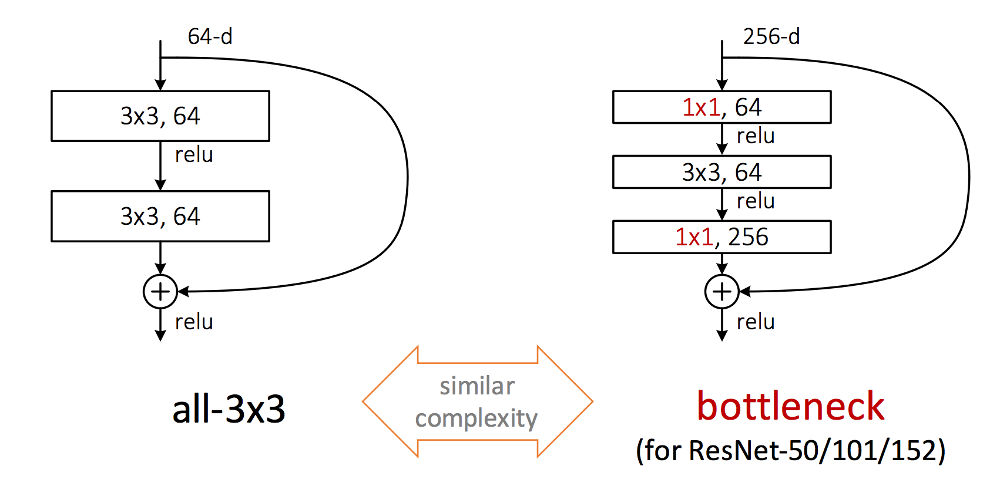

Модели `ResNet-*` состоят из блоков, объединенных в четыре слоя (`layerX`); между слоями происходит 1) понижение размерности HW и 2) увеличение "ширины" блоков (число каналов в картах).

**NB: картинка ниже - для сети ResNet-34, в которой используются "простые" all-3x3 residual-блоки, как на картинке выше слева. В ResNet-50 используются `bottleneck`-блоки (соответственно сверху справа).
Число слоев у этих моделей одинаковое (а вот число блоков в слоях и их ширина отличаются).**

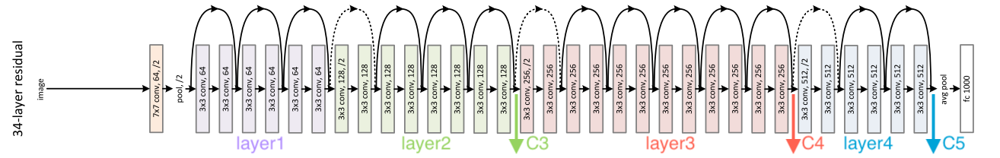

Обычно (для задач типа классификации или регрессии) на выходе модели оказывается вектор (размера `C` = числу классов или 1 - для регрессии).
Но для задачи детектирования понадобятся промежуточные карты активаций, на основе который будет построена пирамида.
На рисунке выше указаны карты `C3`, `C4` и `C5` - их и должен вернуть метод `.forward` нашей базовой сети.

In [ ]:
def conv3x3(in_planes, out_planes, stride=1):
    """3x3 convolution with padding"""
    return nn.Conv2d(in_planes, out_planes, kernel_size=3, stride=stride,
                     padding=1, bias=False)


class BasicBlock(nn.Module):
    expansion = 1

    def __init__(self, inplanes, planes, stride=1, downsample=None):
        super(BasicBlock, self).__init__()
        self.conv1 = conv3x3(inplanes, planes, stride)
        self.bn1 = nn.BatchNorm2d(planes)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = conv3x3(planes, planes)
        self.bn2 = nn.BatchNorm2d(planes)
        self.downsample = downsample
        self.stride = stride

    def forward(self, x):
        residual = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)

        if self.downsample is not None:
            residual = self.downsample(x)

        out += residual
        out = self.relu(out)

        return out


class Bottleneck(nn.Module):
    expansion = 4

    def __init__(self, inplanes, planes, stride=1, downsample=None):
        super(Bottleneck, self).__init__()
        self.conv1 = nn.Conv2d(inplanes, planes, kernel_size=1, bias=False)
        self.bn1 = nn.BatchNorm2d(planes)
        self.conv2 = nn.Conv2d(planes, planes, kernel_size=3, stride=stride,
                               padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(planes)
        self.conv3 = nn.Conv2d(planes, planes * 4, kernel_size=1, bias=False)
        self.bn3 = nn.BatchNorm2d(planes * 4)
        self.relu = nn.ReLU(inplace=True)
        self.downsample = downsample
        self.stride = stride

    def forward(self, x):
        residual = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)
        out = self.relu(out)

        out = self.conv3(out)
        out = self.bn3(out)

        if self.downsample is not None:
            residual = self.downsample(x)

        out += residual
        out = self.relu(out)

        return out

**Задание**: реализовать метод `.forward()`, который должен возвращать карты активаций после слоев `layer2`, `layer3`, `layer4` в виде списка/кортежа.

In [ ]:
class ResNet(nn.Module):

    def __init__(self, num_classes, block, layers_sizes):
        """
        ResNet constructor.

        Args:
            - num_classes: int number of outputs for model.
            - block: class to use as residual block in model (BasicBlock or Bottleneck).
            - layers_sizes: list of sizes (number of blocks) for each of the 4 layers.
        """
        self.inplanes = 64
        super(ResNet, self).__init__()

        # Input convolution: larger (7x7) and with increased stride (2).
        self.conv1 = nn.Conv2d(3, 64, kernel_size=7, stride=2, padding=3, bias=False)
        self.bn1 = nn.BatchNorm2d(64)
        self.relu = nn.ReLU(inplace=True)
        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)

        # Four layers with residual blocks. Each layer has similar structure
        self.layer1 = self._make_layer(block, 64, layers_sizes[0])
        self.layer2 = self._make_layer(block, 128, layers_sizes[1], stride=2)
        self.layer3 = self._make_layer(block, 256, layers_sizes[2], stride=2)
        self.layer4 = self._make_layer(block, 512, layers_sizes[3], stride=2)

    def _make_layer(self, block, planes, num_blocks, stride=1):
        """
        Method to create layer for ResNet using residual blocks.

        Args:
            - block: class to use as residual block in model (BasicBlock or Bottleneck).
            - planes: number of channels in layer's activation maps (also known as layer 'width').
            - num_blocks: number of blocks in layer.

        Returns:
            nn.Sequential object containing residual blocks.
        """
        downsample = None
        if stride != 1 or self.inplanes != planes * block.expansion:
            downsample = nn.Sequential(
                nn.Conv2d(self.inplanes, planes * block.expansion,
                          kernel_size=1, stride=stride, bias=False),
                nn.BatchNorm2d(planes * block.expansion),
            )

        layers = [block(self.inplanes, planes, stride, downsample)]
        self.inplanes = planes * block.expansion
        for i in range(1, num_blocks):
            layers.append(block(self.inplanes, planes))

        return nn.Sequential(*layers)

    def forward(self, inputs):
        """
        Method for "__call__".

        Args:
            - inputs: batch of images shaped Bx3xHxW.

        Returns:
            List of feature maps tensors from layers 2, 3, 4.
        """

        # TODO:
        # Write code to run all the model layers (do not forget to run input convolution/bn/activation/pooling)
        # and to return feature maps from layer2, layer3, layer4.

        x = self.conv1(inputs)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)

        # Pass through the four layers
        x1 = self.layer1(x)  # Layer 1 output (not returned)
        x2 = self.layer2(x1)  # Layer 2 output
        x3 = self.layer3(x2)  # Layer 3 output
        x4 = self.layer4(x3)  # Layer 4 output

        ### END OF YOUR CODE

        return (x2, x3, x4)

In [ ]:
num_classes = 80

print("ResNet50:")
resnet50_layers_sizes = [3, 4, 6, 3]
resnet50 = ResNet(num_classes=num_classes, block=Bottleneck, layers_sizes=resnet50_layers_sizes).to(device)

print(resnet50)

ResNet50:
ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), s

In [ ]:
print("Feature maps sizes from layer2-4 of ResNet50:")
feature_maps_example = resnet50(tensor_example)
for fm in feature_maps_example:
    print(fm.size())

Feature maps sizes from layer2-4 of ResNet50:
torch.Size([1, 512, 68, 100])
torch.Size([1, 1024, 34, 50])
torch.Size([1, 2048, 17, 25])


---

#### 1.1.2 Feature Pyramid: собираем пирамиду активаций

Теперь перейдем к модулю, который сделает из последовательности карт активаций пирамиду.

Идея `Feature Pyramid` в том, чтобы, скомбинировав карты с разных слоев основной сети (`backbone`), получить карты одновременно "семантически богатые" и с большим рецептивным полем.

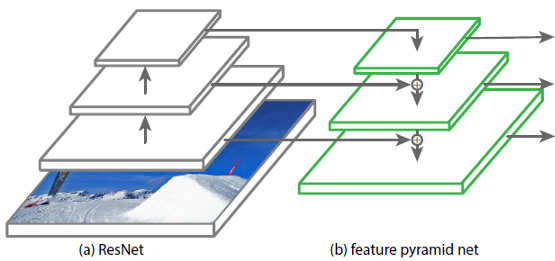

На рисунке выше изображена пирамида из 3 уровней. Авторы [оригинальной статьи](https://arxiv.org/pdf/1708.02002.pdf) указывают (примечание на стр.4), что в их пирамиде 5 слоев, которые обозначаются от $P_3$ до $P_7$. При этом соответствие слоев пирамиды картам активации такое: $C_3 - P_3$, $C_4 - P_4$, $C_5 - P_5$, а два дополнительных слоя пирамиды $P_6$ и $P_7$ получаются последовательно свертками из $P_5$ (уже без сложения с низкоуровневыми картами)

Каждая из карт $C_i$ ($C_5$ - $C_3$):
1. Сворачивается с ядром 1х1, получается $C'_i$
2. Суммируется с выходной картой выше $C'_{i+1}$ (нет у $C_5$), увеличенной вдвое, и после свертки с ядром 3х3 отправляется на выход ($P_i$).

**Задание**: реализовать кусок метода `.forward()` для вычисления `P3` (по аналогии с `P5` & `P4`).

In [ ]:
class PyramidFeatures(nn.Module):

    def __init__(self, C3_size, C4_size, C5_size, feature_size=256):
        """
        FPN constructor.

        Args:
            - C3_size: num features in C3 map.
            - C4_size: num features in C4 map.
            - C5_size: num features in C5 map.
            - feature_size: num features in output maps.
        """
        super(PyramidFeatures, self).__init__()

        # For P5
        self.P5_1 = nn.Conv2d(C5_size, feature_size, kernel_size=1, stride=1, padding=0)
        self.P5_upsampled = nn.Upsample(scale_factor=2, mode='nearest')
        self.P5_2 = nn.Conv2d(feature_size, feature_size, kernel_size=3, stride=1, padding=1)

        # For P4
        self.P4_1 = nn.Conv2d(C4_size, feature_size, kernel_size=1, stride=1, padding=0)
        self.P4_upsampled = nn.Upsample(scale_factor=2, mode='nearest')
        self.P4_2 = nn.Conv2d(feature_size, feature_size, kernel_size=3, stride=1, padding=1)

        # For P3
        self.P3_1 = nn.Conv2d(C3_size, feature_size, kernel_size=1, stride=1, padding=0)
        self.P3_2 = nn.Conv2d(feature_size, feature_size, kernel_size=3, stride=1, padding=1)

        # For P6
        # "P6 is obtained via a 3x3 stride-2 conv on C5"
        self.P6 = nn.Conv2d(C5_size, feature_size, kernel_size=3, stride=2, padding=1)

        # For P7
        # "P7 is computed by applying ReLU followed by a 3x3 stride-2 conv on P6"
        self.P7_1 = nn.ReLU()
        self.P7_2 = nn.Conv2d(feature_size, feature_size, kernel_size=3, stride=2, padding=1)

    def forward(self, inputs):
        """
        Method for "__call__".

        Args:
            - inputs: List of C3, C4, C5 activation maps from backbone.

        Returns:
            List of pyramid feature maps from P3 to P7.
        """
        C3, C4, C5 = inputs

        P5_x = self.P5_1(C5)
        P5_upsampled_x = self.P5_upsampled(P5_x)
        P5_x = self.P5_2(P5_x)

        P4_x = self.P4_1(C4)
        P4_x = P5_upsampled_x + P4_x
        P4_upsampled_x = self.P4_upsampled(P4_x)
        P4_x = self.P4_2(P4_x)

        # TODO:
        # Write code to compute P3_x output map.
        # Almost like P4_x & P5_x, but no need for upsampling itself
        # (as we do not have 'lower' map P2)

        # YOUR CODE HERE

        P3_x = self.P3_1(C3)  # 1x1 conv to reduce channels
        P3_x = P4_upsampled_x + P3_x  # Add upsampled P4 to P3
        P3_x = self.P3_2(P3_x)

        # END OF YOUR CODE

        P6_x = self.P6(C5)

        P7_x = self.P7_1(P6_x)
        P7_x = self.P7_2(P7_x)

        return (P3_x, P4_x, P5_x, P6_x, P7_x)

In [ ]:
fpn_sizes = (512, 1024, 2048)  # ResNet50
fpn = PyramidFeatures(*fpn_sizes).to(device)

print("Feature pyramid sizes:")
features_pyramid_example = fpn(feature_maps_example)
for fp in features_pyramid_example:
    print(fp.size())

Feature pyramid sizes:
torch.Size([1, 256, 68, 100])
torch.Size([1, 256, 34, 50])
torch.Size([1, 256, 17, 25])
torch.Size([1, 256, 9, 13])
torch.Size([1, 256, 5, 7])


Обратим внимание:
* У первого слоя (который мы называем $P_3$) линейные размеры в 8 = $2^3$ раз меньше, чем у оригинального изображения.
* На каждом слое пирамиды линейные размеры уменьшаются вдвое.

То есть размеры слоя $P_i$ меньше размеров исходного изображения в $2^i$ раз.

---

На данный момент у нас есть инструменты для извлечения карт признаков из изображения.

Теперь, если бы мы работали в парадигме, например, `Fast R-CNN`, мы бы запустили на этих признаках алгоритм `SelectiveSearch`, получили координаты предполагаемых локаций с объектами (в виде обрамляющих прямоугольников), "вырезали" их проекции из каждого слоя пирамиды признаков и подали в подсети для определения классов и регрессии относительных координат.

Но, поскольку мы работаем в парадигме single-shot-детектирования, мы сделаем все за один проход.
С каждым супер-пикселем любого из слоев пирамиды (супер-пиксель - это одна точка (x, y) на карте признаков) мы ассоциируем некоторую область на исходном изображении, и для каждой такой области назначим набор т.н. `proposals`, то есть предполагаемых обрамляющих прямоугольников, лежащих в этой области.



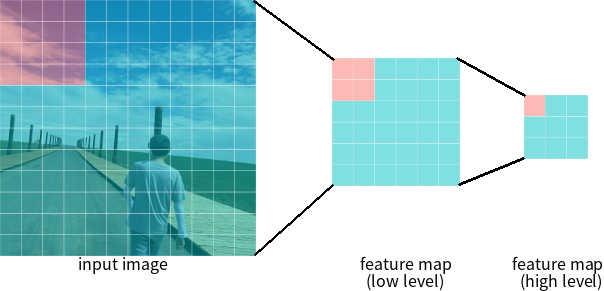

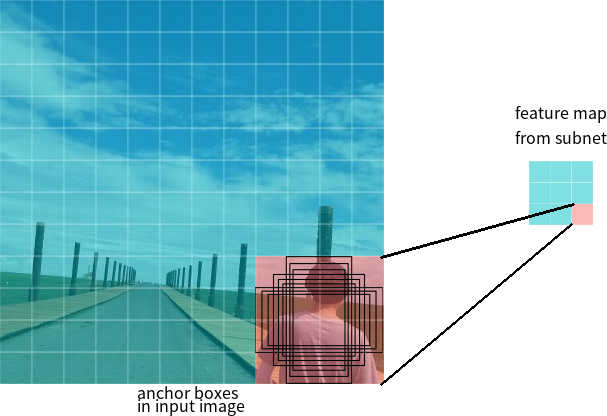


Эти наборы нужны для того, чтобы связать суперпиксели активационных карт с ground-truth объектами при обучении.

---

#### 1.1.3 Anchors Generator


В качестве основы для набора `proposals` возьмем три прямоугольника: "горизонтальный" (соотношение сторон H:W = 1:2, в коде - `ratio`), "квадрат" (H:W = 1:2) и "вертикальный" (H:W = 2:1).

Если кроме 3 вариантов соотношения сторон взять 3 варианта для масштаба, получим набор из 9 прямоугольников.

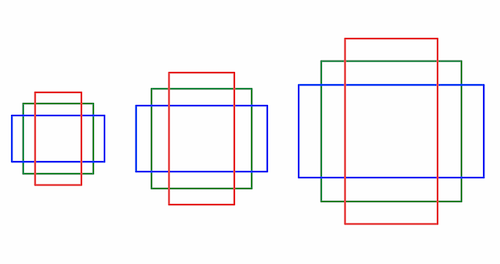

После того, как зафиксирован набор `proposals` для одного супер-пикселя, нужно отобразить все прямоугольники (для всех супер-пикселей на всех уровнях пирамиды) на исходное изображение, чтобы связать их с ground-truth прямоугольниками объектов.

Класс `AnchorsGenerator` нужен затем, чтобы сгенерировать наборы `proposals` для всех слоев, раскидать их по сетке и спроецировать на исходное изображение.

**NB: Конкретные положения прямоугольников зависят как от гипер-параметров генератора, так и от размеров изображения!**

In [ ]:
def generate_anchors(base_size=16, ratios=None, scales=None):
    """
    Generate anchor (reference) windows by enumerating aspect ratios X
    scales w.r.t. a reference window.
    """

    if ratios is None:
        ratios = np.array([0.5, 1, 2])

    if scales is None:
        scales = np.array([2 ** 0, 2 ** (1.0 / 3.0), 2 ** (2.0 / 3.0)])

    num_anchors = len(ratios) * len(scales)

    # initialize output anchors
    anchors = np.zeros((num_anchors, 4))

    # scale base_size
    anchors[:, 2:] = base_size * np.tile(scales, (2, len(ratios))).T

    # compute areas of anchors
    areas = anchors[:, 2] * anchors[:, 3]

    # correct for ratios
    anchors[:, 2] = np.sqrt(areas / np.repeat(ratios, len(scales)))
    anchors[:, 3] = anchors[:, 2] * np.repeat(ratios, len(scales))

    # transform from (x_ctr, y_ctr, w, h) -> (x1, y1, x2, y2)
    anchors[:, 0::2] -= np.tile(anchors[:, 2] * 0.5, (2, 1)).T
    anchors[:, 1::2] -= np.tile(anchors[:, 3] * 0.5, (2, 1)).T

    return anchors


def shift(shape, stride, anchors):
    shift_x = (np.arange(0, shape[1]) + 0.5) * stride
    shift_y = (np.arange(0, shape[0]) + 0.5) * stride

    shift_x, shift_y = np.meshgrid(shift_x, shift_y)

    shifts = np.vstack((
        shift_x.ravel(), shift_y.ravel(),
        shift_x.ravel(), shift_y.ravel()
    )).transpose()

    # add A anchors (1, A, 4) to
    # cell K shifts (K, 1, 4) to get
    # shift anchors (K, A, 4)
    # reshape to (K*A, 4) shifted anchors
    A = anchors.shape[0]
    K = shifts.shape[0]
    all_anchors = (anchors.reshape((1, A, 4)) + shifts.reshape((1, K, 4)).transpose((1, 0, 2)))
    all_anchors = all_anchors.reshape((K * A, 4))

    return all_anchors

In [ ]:
class AnchorsGenerator(nn.Module):

    def __init__(self, pyramid_levels=None, strides=None, sizes=None, ratios=None, scales=None, device=None):
        """
        AnchorGenerator constructor.

        Args:
            - pyramid_levels: list of log_2(image_width / pyramid_level_width) for every pyramid level.
            - strides: list of step sizes for sliding each anchor box set for every pyramid level.
            - sizes: list of basic sizes for anchor boxes for every pyramid level.
            - ratios: list of anchor boxes aspect ratio sets for every pyramid level.
            - scales: list of anchor boxes scale sets for every pyramid level.
            - device: device to move results to.
        """
        super(AnchorsGenerator, self).__init__()

        if pyramid_levels is None:
            self.pyramid_levels = [3, 4, 5, 6, 7]
        if strides is None:
            self.strides = [2 ** x for x in self.pyramid_levels]
        if sizes is None:
            self.sizes = [2 ** (x + 2) for x in self.pyramid_levels]
        if ratios is None:
            self.ratios = np.array([0.5, 1, 2])
        if scales is None:
            self.scales = np.array([2 ** 0, 2 ** (1.0 / 3.0), 2 ** (2.0 / 3.0)])

        if device is None:
            device = torch.cuda.is_available() and 'cuda' or 'cpu'
        self.device = device

    def forward(self, image, verbose=False):
        """
        Method for "__call__".

        Args:
            - image: tensor of shape B x C x H x W.

        Returns:
            tensor of computed anchor box coordinatates, size total_num_anchors x 4.
        """
        image_shape = image.shape[2:]  # h, w
        image_shape = np.array(image_shape)
        image_shapes = [(image_shape + 2 ** x - 1) // (2 ** x) for x in self.pyramid_levels]

        # Compute anchors over all pyramid levels

        all_anchors = np.zeros((0, 4)).astype(np.float32)

        for idx, p in enumerate(self.pyramid_levels):

            # Generate 9 anchors
            anchors = generate_anchors(base_size=self.sizes[idx], ratios=self.ratios, scales=self.scales)

            # Grid all over the shape with stride
            shifted_anchors = shift(image_shapes[idx], self.strides[idx], anchors)

            if verbose:
                print(f"{idx}\tpyr_level = {p}\tstride = {self.strides[idx]:3d}\tsize={self.sizes[idx]:3d}\tanchors shape = {shifted_anchors.shape}")

            all_anchors = np.append(all_anchors, shifted_anchors, axis=0)

        all_anchors = np.expand_dims(all_anchors, axis=0)

        return torch.from_numpy(all_anchors.astype(np.float32)).to(self.device)

In [ ]:
anchors_generator = AnchorsGenerator(device=device)

anchors_example = anchors_generator(tensor_example, verbose=True)[0].cpu()
print()
print(anchors_example.size())

0	pyr_level = 3	stride =   8	size= 32	anchors shape = (61200, 4)
1	pyr_level = 4	stride =  16	size= 64	anchors shape = (15300, 4)
2	pyr_level = 5	stride =  32	size=128	anchors shape = (3825, 4)
3	pyr_level = 6	stride =  64	size=256	anchors shape = (1053, 4)
4	pyr_level = 7	stride = 128	size=512	anchors shape = (315, 4)

torch.Size([81693, 4])


Получили общее число `proposals`, каждый из которых задается четырьмя числами - x1, y1, x2, y2.

Отрисуем по несколько полученных прямоугольников с каждого слоя на исходном изображении.

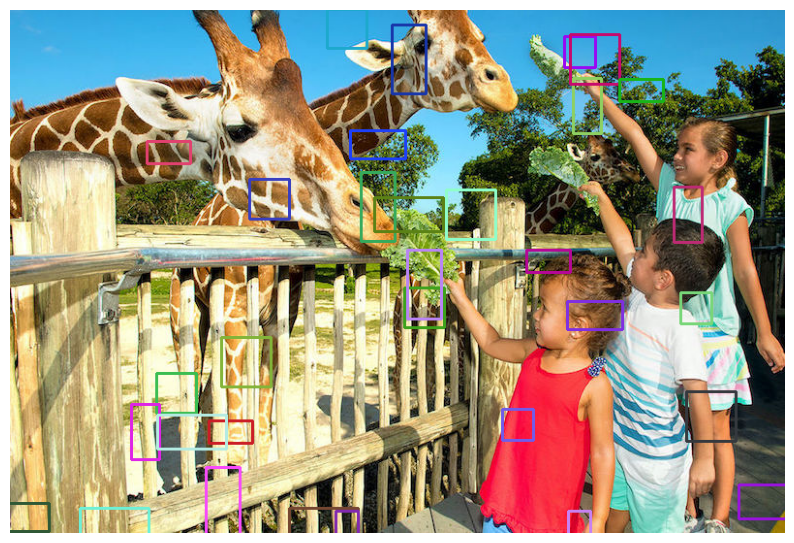

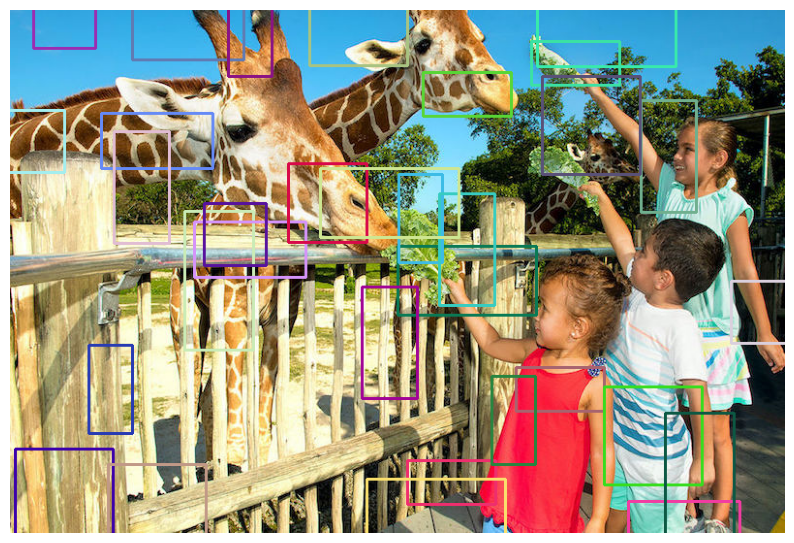

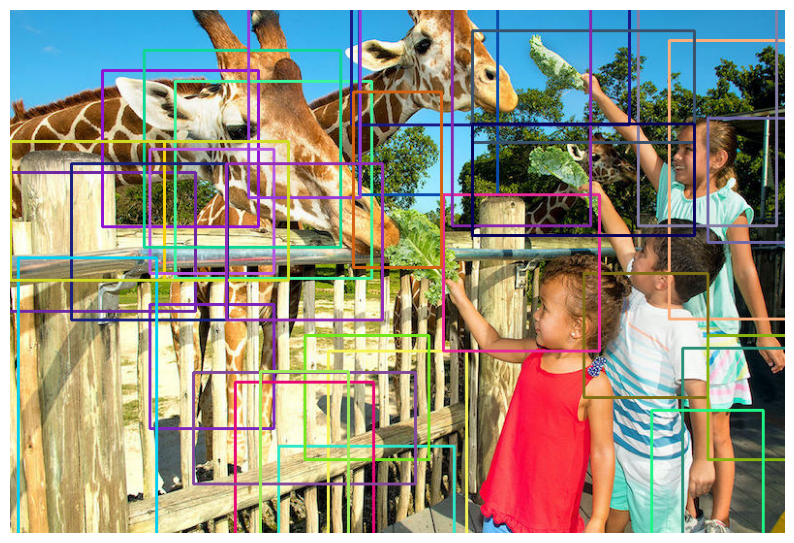

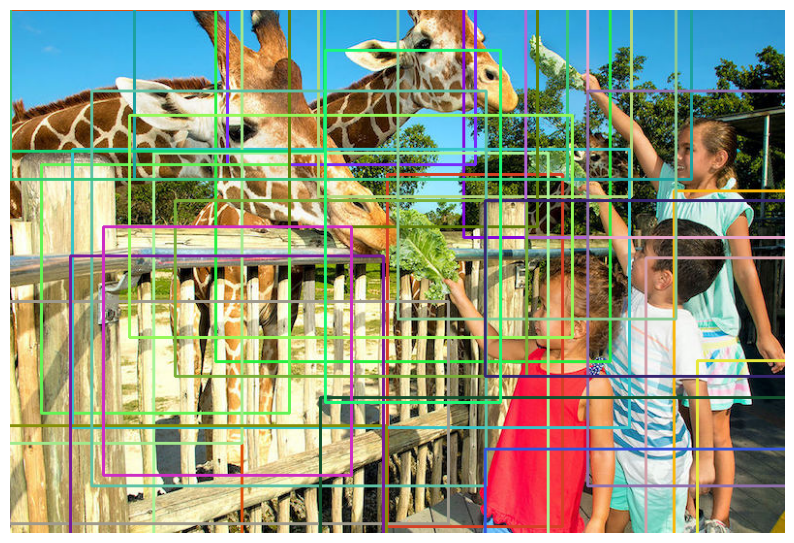

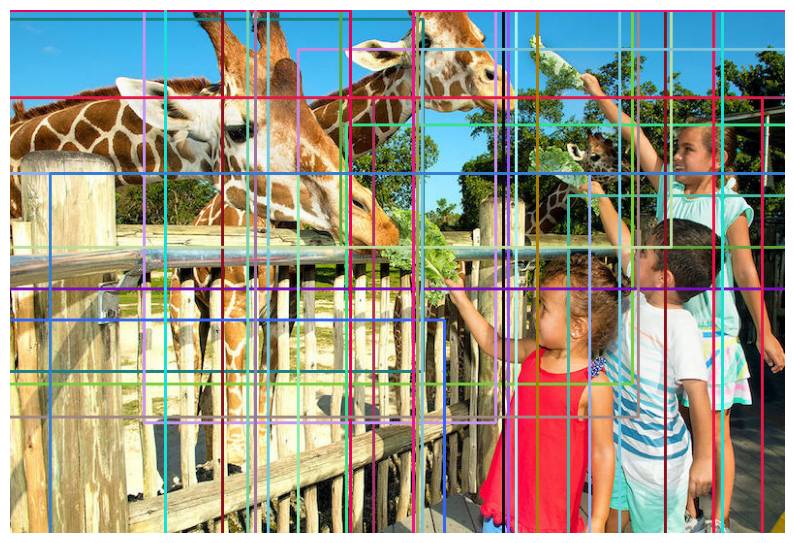

In [ ]:
anchors_num_per_level = [61200, 15300, 3825, 1053, 315]
anchors_per_level = np.split(anchors_example, np.cumsum(anchors_num_per_level)[:-1])

num_to_show = 32
for anchor_boxes_level in anchors_per_level:
    image_example_with_anchors = image_example.copy()
    for i in np.random.choice(len(anchor_boxes_level), size=num_to_show):
        anchor_box = anchor_boxes_level[i]
        x1, y1, x2, y2 = anchor_box.numpy().astype(np.int32)
        cv2.rectangle(image_example_with_anchors, (x1, y1), (x2, y2), np.random.randint(255, size=3).tolist(), 2)

    show_image(image_example_with_anchors)

Теперь, когда у нас есть модуль для генерации якорных прямоугольников, можем перейти к сеткам для классификации и регрессии на их основе.

---

#### 1.1.4 Regression & Classification subnets

Классификацию (объект одного из классов или фон) и регрессию (уточнение координат объекта относительно `anchor box`) будет делать в сверточной манере.

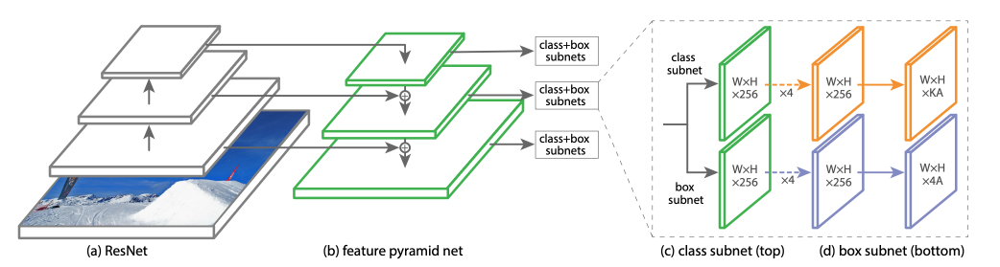

**Регрессия**

Поскольку с каждым супер-пикселем у нас ассоциировано 9 разных `proposals`, каждый из которых задан с помощью 4 чисел, то для регрессии нам потребуется 9 x 4 = 36 чисел в каждом суперпикселе. Значит, сделаем полносверточную сеть, которая не меняет размера карт активаций (то есть нет `pooling`-слоев и `stride`=1) и имеет на выходе 36 каналов. Таким образом, в каждом из `HxW` суперпикселей выходной карты будут храниться все необходимые таргеты.

**Задание:** напишите код для преобразования тензора с результатами из вида `B x (num_anchors * 4) x H x W` к виду `B x total_num_anchors x 4`.

In [ ]:
class RegressionModel(nn.Module):

    def __init__(self, num_features_in, num_anchors=9, feature_size=256):
        """
        RegressionModel consctructor.

        RegressionModel is a fully-convolutional neural network that takes single feature pyramid level and
        outputs tensor of size total_number_of_anchors x 4.

        Args:
            - num_features_in: number of channels in every feature pyramid level.
            - num_anchors: size of anchor boxes set.
            - feature_size: size of internal activation maps.
        """
        super(RegressionModel, self).__init__()

        self.conv1 = nn.Conv2d(num_features_in, feature_size, kernel_size=3, padding=1)
        self.act1 = nn.ReLU()

        self.conv2 = nn.Conv2d(feature_size, feature_size, kernel_size=3, padding=1)
        self.act2 = nn.ReLU()

        self.conv3 = nn.Conv2d(feature_size, feature_size, kernel_size=3, padding=1)
        self.act3 = nn.ReLU()

        self.conv4 = nn.Conv2d(feature_size, feature_size, kernel_size=3, padding=1)
        self.act4 = nn.ReLU()

        self.output = nn.Conv2d(feature_size, num_anchors * 4, kernel_size=3, padding=1)

    def forward(self, x):
        """
        Run regression on single feature pyramid level.

        Args:
            - x: feature pyramid level of shape B x num_features_in x H x W.

        Returns:
            tensor of size B x (H * W * num_anchors) x 4.
        """
        out = self.conv1(x)
        out = self.act1(out)

        out = self.conv2(out)
        out = self.act2(out)

        out = self.conv3(out)
        out = self.act3(out)

        out = self.conv4(out)
        out = self.act4(out)

        out = self.output(out)
        # out is B x C x H x W, with C = 4 * num_anchors

        # TODO: change shape of `out` tensor to be `B x total_num_anchors x 4`.

        B, _, H, W = out.shape
        out = out.view(B, -1, 4, H, W)
        out = out.permute(0, 3, 4, 1, 2)
        out = out.reshape(B, -1, 4)

        # END OF YOUR CODE

        return out

In [ ]:
num_features_in = 256
regression_head = RegressionModel(num_features_in).to(device)

regression_predictions = []
for features in features_pyramid_example:
    regression_predictions_at_level = regression_head(features)
    regression_predictions.append(regression_predictions_at_level)
    print(f"input: {features.size()}\t output: {regression_predictions_at_level.size()}")
regression_predictions = torch.cat(regression_predictions, dim=1) # batch x anchors x 4 [4 for bbox]

input: torch.Size([1, 256, 68, 100])	 output: torch.Size([1, 61200, 4])
input: torch.Size([1, 256, 34, 50])	 output: torch.Size([1, 15300, 4])
input: torch.Size([1, 256, 17, 25])	 output: torch.Size([1, 3825, 4])
input: torch.Size([1, 256, 9, 13])	 output: torch.Size([1, 1053, 4])
input: torch.Size([1, 256, 5, 7])	 output: torch.Size([1, 315, 4])


**Классификация**

Архитектурно голова классификации идентична голове регрессии, отличие только в размере выхода (и активации): модель возвращает столько значений для каждого бокса, сколько классов в датасете, причем с активацией `Sigmoid`.

In [ ]:
class ClassificationModel(nn.Module):

    def __init__(self, num_features_in, num_anchors=9, num_classes=80, prior=0.01, feature_size=256):
        """
        ClassificationModel consctructor.

        ClassificationModel is a fully-convolutional neural network that takes single feature pyramid level and
        outputs tensor of size total_number_of_anchors x num_classes.

        Args:
            - num_features_in: number of channels in every feature pyramid level.
            - num_anchors: size of anchor boxes set.
            - num_classes: number of classes in dataset (do not count the `background` class!).
            - prior: float number to use in weights initializatin.
            - feature_size: size of internal activation maps.
        """
        super(ClassificationModel, self).__init__()

        self.num_classes = num_classes
        self.num_anchors = num_anchors

        self.conv1 = nn.Conv2d(num_features_in, feature_size, kernel_size=3, padding=1)
        self.act1 = nn.ReLU()

        self.conv2 = nn.Conv2d(feature_size, feature_size, kernel_size=3, padding=1)
        self.act2 = nn.ReLU()

        self.conv3 = nn.Conv2d(feature_size, feature_size, kernel_size=3, padding=1)
        self.act3 = nn.ReLU()

        self.conv4 = nn.Conv2d(feature_size, feature_size, kernel_size=3, padding=1)
        self.act4 = nn.ReLU()

        self.output = nn.Conv2d(feature_size, num_anchors * num_classes, kernel_size=3, padding=1)
        self.output_act = nn.Sigmoid()

    def forward(self, x):
        """
        Run classification on single feature pyramid level.

        Args:
            - x: feature pyramid level of shape B x num_features_in x H x W.

        Returns:
            tensor of size B x (H * W * num_anchors) x num_classes.
        """
        out = self.conv1(x)
        out = self.act1(out)

        out = self.conv2(out)
        out = self.act2(out)

        out = self.conv3(out)
        out = self.act3(out)

        out = self.conv4(out)
        out = self.act4(out)

        out = self.output(out)
        out = self.output_act(out)
        # out is B x C x W x H, with C = num_classes * num_anchors

        out1 = out.permute(0, 2, 3, 1)
        batch_size, width, height, channels = out1.shape
        out2 = out1.reshape(batch_size, width, height, self.num_anchors, self.num_classes)

        return out2.reshape(x.shape[0], -1, self.num_classes)

In [ ]:
classification_head = ClassificationModel(num_features_in, num_classes=num_classes).to(device)
classification_results = []

for feature in features_pyramid_example:
    classification_results_at_level = classification_head(feature)
    classification_results.append(classification_results_at_level)
    print(f"input: {feature.size()}\t output: {classification_results_at_level.size()}")
classification_results = torch.cat(classification_results, dim=1) # batch x anchors x classes

input: torch.Size([1, 256, 68, 100])	 output: torch.Size([1, 61200, 80])
input: torch.Size([1, 256, 34, 50])	 output: torch.Size([1, 15300, 80])
input: torch.Size([1, 256, 17, 25])	 output: torch.Size([1, 3825, 80])
input: torch.Size([1, 256, 9, 13])	 output: torch.Size([1, 1053, 80])
input: torch.Size([1, 256, 5, 7])	 output: torch.Size([1, 315, 80])


Теперь мы можем объединить все в одну композицию, класс `RetinaNet`.

---

### 1.2 Собираем RetinaNet

Из интересного: метод `.forward()` работает по разному во время обучения и во время инференса:
- Во время обучения (`self.training = True`) функция возвращает список из двух лоссов - регрессионного и классификационного.
- Во время инференса функция возвращает предсказания: скоры, индексы классов и координаты боксов.

Как было сказано ранне основной фичей RetinaNet является Focal loss ([paper](https://arxiv.org/pdf/1708.02002.pdf)):

$$\text{FL}(p_t) = -(1-p_t)^\gamma \log p_t$$

где $p_t = \text{sigmoid}(x)$ для позитивного класса и $p_t = 1- \text{sigmoid}(x) = \text{sigmoid}(-x)$ для негативного.


`FocalLoss`: класс для вычисления сложной функции потерь (на самом деле, в нем вычисляются оба лосса - для классификации и для регрессии).
  Внутри него происходит, например, ассоциация GT-боксов с якорными боксами.

In [ ]:
def calc_iou(a, b):
    area = (b[:, 2] - b[:, 0]) * (b[:, 3] - b[:, 1])

    iw = torch.min(torch.unsqueeze(a[:, 2], dim=1), b[:, 2]) - torch.max(torch.unsqueeze(a[:, 0], 1), b[:, 0])
    ih = torch.min(torch.unsqueeze(a[:, 3], dim=1), b[:, 3]) - torch.max(torch.unsqueeze(a[:, 1], 1), b[:, 1])

    iw = torch.clamp(iw, min=0)
    ih = torch.clamp(ih, min=0)

    ua = torch.unsqueeze((a[:, 2] - a[:, 0]) * (a[:, 3] - a[:, 1]), dim=1) + area - iw * ih

    ua = torch.clamp(ua, min=1e-8)

    intersection = iw * ih

    IoU = intersection / ua

    return IoU


class FocalLoss(nn.Module):
    def __init__(self, device=None):
        super(FocalLoss, self).__init__()
        if device is None:
            device = torch.cuda.is_available() and 'cuda' or 'cpu'
        self.device = device

    def forward(self, classifications, regressions, anchors, annotations):
        device = self.device
        alpha = 0.25
        gamma = 2.0
        batch_size = classifications.shape[0]
        classification_losses = []
        regression_losses = []

        anchor = anchors[0, :, :]

        anchor_widths  = anchor[:, 2] - anchor[:, 0]
        anchor_heights = anchor[:, 3] - anchor[:, 1]
        anchor_ctr_x   = anchor[:, 0] + 0.5 * anchor_widths # X coordinate of the center pixel
        anchor_ctr_y   = anchor[:, 1] + 0.5 * anchor_heights # Y coordinate of the center pixel

        for j in range(batch_size):

            classification = classifications[j, :, :]
            regression = regressions[j, :, :]

            bbox_annotation = annotations[j, :, :]
            bbox_annotation = bbox_annotation[bbox_annotation[:, 4] != -1]

            if bbox_annotation.shape[0] == 0:
                regression_losses.append(torch.tensor(0).float().to(device))
                classification_losses.append(torch.tensor(0).float().to(device))
                continue

            classification = torch.clamp(classification, 1e-4, 1.0 - 1e-4)

            IoU = calc_iou(anchors[0, :, :], bbox_annotation[:, :4]) # num_anchors x num_annotations

            IoU_max, IoU_argmax = torch.max(IoU, dim=1) # num_anchors x 1

            # compute the loss for classification
            targets = torch.ones(classification.shape) * -1

            targets = targets.to(device)

            """Specifically, anchors are assigned to ground-truth object boxes using an intersection-over-union (IoU)
             threshold of 0.5; and to background if their IoU is in [0, 0.4).
             If an anchor is unassigned, which may happen with overlap in [0.4, 0.5), it is ignored during training"""

            targets[torch.lt(IoU_max, 0.4), :] = 0

            positive_indices = torch.ge(IoU_max, 0.5)

            num_positive_anchors = positive_indices.sum()

            assigned_annotations = bbox_annotation[IoU_argmax, :]

            """As each anchor is assigned to at most one object box, we set the corresponding entry
             in its length K label vector to 1 and all other entries to 0"""
            targets[positive_indices, :] = 0
            targets[positive_indices, assigned_annotations[positive_indices, 4].long()] = 1  # only top classes get 1, other -1

            """
            A common method for addressing class imbalance is to introduce a weighting factor
            α ∈ [0, 1] for class 1 and 1−α for class −1.
            In practice α may be set by inverse class frequency or treated as a hyperparameter to set by cross validation
            We adopt this form in our experiments as it yields slightly improved accuracy over the non-α-balanced form
            """
            # alpha_t = y == 1 and alfa or 1 - alpha
            alpha_factor = torch.ones(targets.shape).to(device) * alpha

            alpha_factor = torch.where(torch.eq(targets, 1.), alpha_factor, 1. - alpha_factor) # even more balance
            # 1 - p_t
            focal_weight = torch.where(torch.eq(targets, 1.), 1. - classification, classification)
            # alfa * (1 - p_t)** gamma
            focal_weight = alpha_factor * torch.pow(focal_weight, gamma)

            bce = -(targets * torch.log(classification) + (1.0 - targets) * torch.log(1.0 - classification))

            # modified Cross Entropy
            cls_loss = focal_weight * bce

            cls_loss = torch.where(torch.ne(targets, -1.0), cls_loss, torch.zeros(cls_loss.shape).to(device)) # compute loss only for +1 targets

            classification_losses.append(cls_loss.sum()/torch.clamp(num_positive_anchors.float(), min=1.0))

            # compute the loss for regression

            if positive_indices.sum() > 0:
                """we predict dx, dy, s_x, s_y, but annotations are bounding boxes x1,y1,x2,y2,
                and anchors are a grid of boxes
                so here we convert from absolute ground truth bboxes to relative of given anchors
                annotations -> dx,dy,sx,sy
                """
                assigned_annotations = assigned_annotations[positive_indices, :] # pick assigned anchors

                #w,h,centers of assigned anchors
                anchor_widths_pi = anchor_widths[positive_indices]
                anchor_heights_pi = anchor_heights[positive_indices]
                anchor_ctr_x_pi = anchor_ctr_x[positive_indices]
                anchor_ctr_y_pi = anchor_ctr_y[positive_indices]

                # annotations: boxes -> h,w,centers
                gt_widths  = assigned_annotations[:, 2] - assigned_annotations[:, 0]
                gt_heights = assigned_annotations[:, 3] - assigned_annotations[:, 1]
                gt_ctr_x   = assigned_annotations[:, 0] + 0.5 * gt_widths
                gt_ctr_y   = assigned_annotations[:, 1] + 0.5 * gt_heights

                # clip widths to 1
                gt_widths  = torch.clamp(gt_widths, min=1)
                gt_heights = torch.clamp(gt_heights, min=1)

                # annotations -> dx,dy,sx,sy relative to assigned anchors = targets
                targets_dx = (gt_ctr_x - anchor_ctr_x_pi) / anchor_widths_pi
                targets_dy = (gt_ctr_y - anchor_ctr_y_pi) / anchor_heights_pi
                targets_dw = torch.log(gt_widths / anchor_widths_pi)
                targets_dh = torch.log(gt_heights / anchor_heights_pi)

                targets = torch.stack((targets_dx, targets_dy, targets_dw, targets_dh))
                targets = targets.t() # transpose

                targets = targets/torch.Tensor([[0.1, 0.1, 0.2, 0.2]]).to(device) # std

                negative_indices = 1 + (~positive_indices)

                regression_diff = torch.abs(targets - regression[positive_indices, :]) # l1 loss

                # Smooth L1 Loss
                regression_loss = torch.where(
                    torch.le(regression_diff, 1.0 / 9.0),
                    0.5 * 9.0 * torch.pow(regression_diff, 2),
                    regression_diff - 0.5 / 9.0 # subtract small number
                )
                regression_losses.append(regression_loss.mean())
            else:
                regression_losses.append(torch.tensor(0).float().to(device))

        return torch.stack(classification_losses).mean(dim=0, keepdim=True), torch.stack(regression_losses).mean(dim=0, keepdim=True)


Также помимо уже разобранных модулей будут использоваться:
- `BBoxTransform`: класс для сборки боксов из предсказаний регрессионной головы и набора якорных боксов.
- `ClipBoxes`: класс для усечения координат боксов при выходе за границы изображения.

In [ ]:
class BBoxTransform(nn.Module):
    def __init__(self, mean=None, std=None, device=None):
        super(BBoxTransform, self).__init__()
        if device is None:
            device = torch.cuda.is_available() and 'cuda' or 'cpu'

        if mean is None:
            self.mean = torch.from_numpy(np.array([0, 0, 0, 0]).astype(np.float32)).to(device)
        else:
            self.mean = mean
        if std is None:
            self.std = torch.from_numpy(np.array([0.1, 0.1, 0.2, 0.2]).astype(np.float32)).to(device)
        else:
            self.std = std

    def forward(self, boxes, deltas):
        """"boxes are anchors, deltas are our predictions
        here we convert deltas -> to real bounding boxes x1, y1. x2, y2 relative to anchors
        """
        widths  = boxes[:, :, 2] - boxes[:, :, 0]
        heights = boxes[:, :, 3] - boxes[:, :, 1]
        ctr_x   = boxes[:, :, 0] + 0.5 * widths
        ctr_y   = boxes[:, :, 1] + 0.5 * heights

        dx = deltas[:, :, 0] * self.std[0] + self.mean[0]
        dy = deltas[:, :, 1] * self.std[1] + self.mean[1]
        dw = deltas[:, :, 2] * self.std[2] + self.mean[2]
        dh = deltas[:, :, 3] * self.std[3] + self.mean[3]

        pred_ctr_x = ctr_x + dx * widths
        pred_ctr_y = ctr_y + dy * heights
        pred_w     = torch.exp(dw) * widths
        pred_h     = torch.exp(dh) * heights

        pred_boxes_x1 = pred_ctr_x - 0.5 * pred_w
        pred_boxes_y1 = pred_ctr_y - 0.5 * pred_h
        pred_boxes_x2 = pred_ctr_x + 0.5 * pred_w
        pred_boxes_y2 = pred_ctr_y + 0.5 * pred_h

        pred_boxes = torch.stack([pred_boxes_x1, pred_boxes_y1, pred_boxes_x2, pred_boxes_y2], dim=2)

        return pred_boxes


class ClipBoxes(nn.Module):
    def __init__(self, width=None, height=None):
        super(ClipBoxes, self).__init__()

    def forward(self, boxes, img):

        batch_size, num_channels, height, width = img.shape

        boxes[:, :, 0] = torch.clamp(boxes[:, :, 0], min=0)
        boxes[:, :, 1] = torch.clamp(boxes[:, :, 1], min=0)

        boxes[:, :, 2] = torch.clamp(boxes[:, :, 2], max=width)
        boxes[:, :, 3] = torch.clamp(boxes[:, :, 3], max=height)

        return boxes

---

Собираем все вместе

In [ ]:
class RetinaNet(nn.Module):

    def __init__(self, num_classes, backbone="resnet50", fpn_feature_size=256, subnets_feature_size=256, device=None):
        super(RetinaNet, self).__init__()

        self.device = device
        if backbone == "resnet50":
            self.backbone = ResNet(num_classes=num_classes, block=Bottleneck, layers_sizes=(3, 4, 6, 3)).to(device)
            self.fpn = PyramidFeatures(512, 1024, 2048, fpn_feature_size).to(device)

        else:
            raise NotImplementedError(backbone)

        self.regression_head = RegressionModel(num_features_in=fpn_feature_size, feature_size=subnets_feature_size).to(device)
        self.classification_head = ClassificationModel(num_features_in=fpn_feature_size, num_classes=num_classes, feature_size=subnets_feature_size).to(self.device)
        self._init_weights()

        self.anchors_generator = AnchorsGenerator(device=device)
        self.transform_bboxes = BBoxTransform(device=device)
        self.clip_bboxes = ClipBoxes()
        self.loss_fn = FocalLoss(device=device)


    def forward(self, inputs):
        """
        Apply RetinaNet pipeline to inputs.

        Args:
            - inputs: Either (images_batch, annotations) in training mode or images_batch otherwise.
            images_batch is of shape (B x C x H x W), annotations of shape (B x N x 5) where N is a number of
            GT boxes and 5 = 4 coords + 1 class label.

        Returns:
            Either (classification_loss, regression_loss) in training mode or (scores, nms_class, boxes) otherwise.
        """

        if self.training:
            images_batch, annotations = inputs
        else:
            images_batch = inputs

        features = self.backbone(images_batch.to(device))
        features_pyramid = self.fpn(features)
        classification_results = torch.cat([self.classification_head(f) for f in features_pyramid], dim=1)
        regression_results = torch.cat([self.regression_head(f) for f in features_pyramid], dim=1)

        anchors = self.anchors_generator(images_batch)

        if self.training:
            return self.loss_fn(classification_results, regression_results, anchors, annotations)

        transformed_anchors = self.transform_bboxes(anchors, regression_results)
        transformed_anchors = self.clip_bboxes(transformed_anchors, images_batch)

        scores = torch.max(classification_results, dim=2, keepdim=True)[0]
        scores_over_thresh = (scores > 0.3)[0, :, 0]

        if scores_over_thresh.sum() == 0:
            # no boxes to NMS, just return
            return [torch.zeros(0), torch.zeros(0), torch.zeros(0, 4)]

        # NMS iteratively removes lower scoring boxes which have an
        # IoU greater than iou_threshold with another (higher scoring) box
        classification_results = classification_results[:, scores_over_thresh, :]
        transformed_anchors = transformed_anchors[:, scores_over_thresh, :]
        scores = scores[:, scores_over_thresh, :]

        anchors_nms_idx = nms(transformed_anchors[0,:,:], scores[0,:,0], 0.5)

        nms_scores, nms_class = classification_results[0, anchors_nms_idx, :].max(dim=1)

        return [nms_scores, nms_class, transformed_anchors[0, anchors_nms_idx, :]]

    def _init_weights(self):

        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                n = m.kernel_size[0] * m.kernel_size[1] * m.out_channels
                m.weight.data.normal_(0, np.sqrt(2. / n))
            elif isinstance(m, nn.BatchNorm2d):
                m.weight.data.fill_(1)
                m.bias.data.zero_()

        prior = 0.01

        self.classification_head.output.weight.data.fill_(0)
        self.classification_head.output.bias.data.fill_(-np.log((1.0 - prior) / prior))

        self.regression_head.output.weight.data.fill_(0)
        self.regression_head.output.bias.data.fill_(0)

Подгрузим веса из оригинального репозитория (модифицированные для нашего класса) и сделаем пробный прогон на тестовом изображении. Веса получены обучением модели на датасете COCO.

In [ ]:
retinanet = RetinaNet(num_classes=80, device=device)
retinanet.eval();

In [ ]:
with open("/content/dl-6-content/FIXED_coco_resnet_50_map_0_335_state_dict.pt", "rb") as fp:
    state_dict = torch.load(fp, map_location="cpu")
retinanet.load_state_dict(state_dict)

<All keys matched successfully>

---

### 1.3 Применяем RetinaNet

Взглянем на результат работы модели на тестовом примере:

In [ ]:
def run_and_show(model, image_or_tensor, threshold, class_to_label_map, verbose=False):
    if isinstance(image_or_tensor, np.ndarray):
        tensor = make_tensor(image_or_tensor)
        image = image_or_tensor
    elif isinstance(image_or_tensor, torch.Tensor):
        image = (image_or_tensor.numpy()[0] * 0.25) + 0.5
        tensor = image_or_tensor.permute(0, 3, 1, 2)
    else:
        raise NotImplementedError(type(image_or_tensor))

    with torch.no_grad():
        nms_scores, nms_classes, bboxes = model(tensor)

    nms_scores = nms_scores.cpu()
    nms_classes = nms_classes.cpu()
    bboxes = bboxes.cpu()

    if verbose:
        print(nms_scores.size(), nms_scores[:8])
        print(nms_classes.size(), nms_classes[:8])
        print(bboxes.size(), bboxes[:8])

    image_with_predictions = draw_predictions(image, bboxes, nms_scores, nms_classes, class_to_label_map, threshold=threshold)
    show_image(image_with_predictions)

In [ ]:
with open("/content/dl-6-content/coco_id_to_name.json", "rt") as fp:
    coco_class_to_label_map = json.load(fp)
coco_class_to_label_map = {int(k) - 1: v for k, v in coco_class_to_label_map.items()}

torch.Size([9]) tensor([0.9233, 0.9152, 0.9048, 0.6975, 0.6942, 0.6544, 0.3873, 0.3595])
torch.Size([9]) tensor([ 0,  0, 23,  0, 23,  0, 23,  0])
torch.Size([9, 4]) tensor([[449.5888, 243.1150, 640.3467, 536.0121],
        [576.0060,  65.7283, 788.5273, 520.0207],
        [  0.0000,   2.5446, 432.3902, 262.7660],
        [593.4430, 188.3436, 734.5757, 538.8125],
        [160.2017,   6.6155, 513.5728, 313.3862],
        [505.8370, 190.7568, 704.4647, 529.6027],
        [  0.0000,  10.8028, 460.2867, 506.0140],
        [676.0553, 136.6647, 793.7506, 534.0100]])


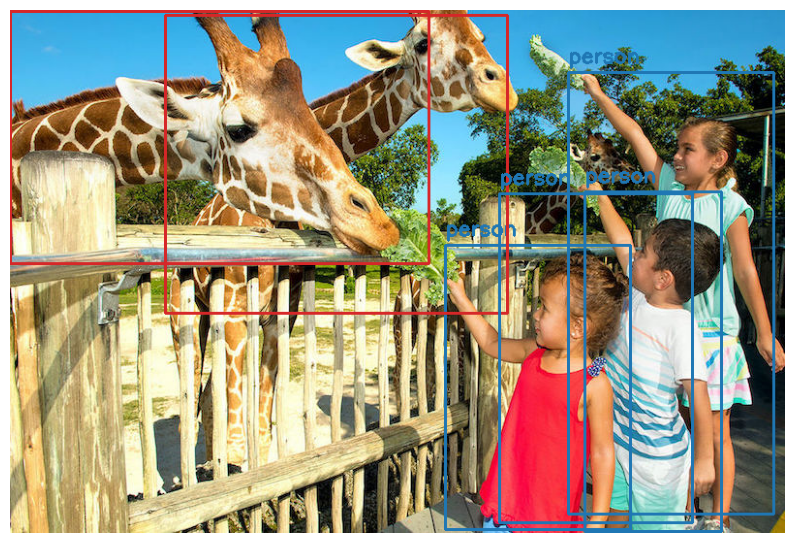

In [ ]:
run_and_show(retinanet, image_example, 0.5, coco_class_to_label_map, verbose=True)

---

### 1.4 Дообучение RetinaNet

Наконец, убедимся в том, что наша модель может обучаться.

У нас есть кусок датасета [OpenImages](https://storage.googleapis.com/openimages/web/index.html), которая содержит примеры класса `Ball`.
Будем обучать нашу модель детектировать 1 класс - мячи, шары и т.д.


#### 1.4.1 Подгрузка данных

In [ ]:
class DetectionDataset(torch.utils.data.Dataset):
    def __init__(self, data_dict_file, transforms=None, add_path=None):
        self.transforms = transforms

        with open(data_dict_file, 'r') as f:
            self.data_dict = json.load(f)
        if add_path:
            self.data_dict = {add_path + i:j for i,j in self.data_dict.items()}

        self.imgs = list(self.data_dict.keys())

    def __getitem__(self, idx):
        # load images ad masks
        img_path = self.imgs[idx]
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB).astype(np.float32) / 255.
        h, w = image.shape[:2]
#         img = Image.open(img_path).convert("RGB")
#         w, h = img.size

        num_objs = len(self.data_dict[img_path])
        boxes = []
        for i in range(num_objs):
            bbox = self.data_dict[img_path][i]
            xmin = bbox[0] * w
            xmax = bbox[1] * w
            ymin = bbox[2] * h
            ymax = bbox[3] * h
            boxes.append([xmin, ymin, xmax, ymax])

        boxes = np.asarray(boxes)  # N x 4
        annot = np.zeros((len(boxes), 1))  # N x 1
        annot = np.concatenate((boxes, annot), axis=1)  # N x 5

        sample = {'img': image, 'annot': annot}

        if self.transforms:
            sample = self.transforms(sample)

        return sample

    def __len__(self):
        return len(self.imgs)

    def image_aspect_ratio(self, image_index):
        img_path = self.imgs[image_index]
        img = Image.open(img_path).convert("RGB") # slow
        w, h = img.size
        return w / h

    def num_classes(self):
        return 2

В задачах компьютерного зрения от набора обучающих данных зависит качество работы сети. Данных требуется много и хочется, чтобы они были наиболее разнородными. Собирать новые данные дорого и долго, поэтому часто используют аугментацию изображений.

Аугментация — создание новых данных на основе какого-то базиса. Можно взять несколько шаблонов / «идеальных» примеров (те данные, которые есть) и с помощью различных искажений расширить набор изображений.
Можно использовать следующие искажения:
* Геометрические (афинные, проективные, ...).
* Яркостные/цветовые.
* Замена фона.
* Искажения, характерные для решаемой задачи: блики, шумы, размытие и т. д.

Популярные библиотеки для аугментации изображений:
* https://pytorch.org/vision/stable/transforms.html
* https://albumentations.ai

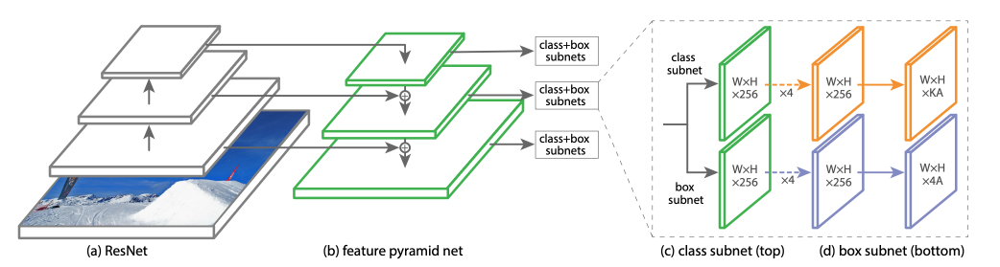

In [ ]:
class Augmenter(object):
    """Convert ndarrays in sample to Tensors."""

    def __call__(self, sample, flip_x=0.5):

        if np.random.rand() < flip_x:
            image, annots = sample['img'], sample['annot']
            image = image[:, ::-1, :]

            rows, cols, channels = image.shape

            x1 = annots[:, 0].copy()
            x2 = annots[:, 2].copy()

            x_tmp = x1.copy()

            annots[:, 0] = cols - x2
            annots[:, 2] = cols - x_tmp

            sample = {'img': image, 'annot': annots}

        return sample

In [ ]:
class Normalizer(object):

    def __init__(self):
        self.mean = np.array([[[0.485, 0.456, 0.406]]])
        self.std = np.array([[[0.229, 0.224, 0.225]]])

    def __call__(self, sample):

        image, annots = sample['img'], sample['annot']

        return {'img':((image.astype(np.float32)-self.mean)/self.std), 'annot': annots}

In [ ]:
class UnNormalizer(object):
    def __init__(self, mean=None, std=None):
        if mean == None:
            self.mean = [0.485, 0.456, 0.406]
        else:
            self.mean = mean
        if std == None:
            self.std = [0.229, 0.224, 0.225]
        else:
            self.std = std

    def __call__(self, tensor):
        """
        Args:
            tensor (Tensor): Tensor image of size (C, H, W) to be normalized.
        Returns:
            Tensor: Normalized image.
        """
        for t, m, s in zip(tensor, self.mean, self.std):
            t.mul_(s).add_(m)
        return tensor

In [ ]:
class Resizer(object):
    """Convert ndarrays in sample to Tensors."""

    def __call__(self, sample, min_side=608, max_side=1024):
        image, annots = sample['img'], sample['annot']

        rows, cols, cns = image.shape

        smallest_side = min(rows, cols)

        # rescale the image so the smallest side is min_side
        scale = min_side / smallest_side

        # check if the largest side is now greater than max_side, which can happen
        # when images have a large aspect ratio
        largest_side = max(rows, cols)

        if largest_side * scale > max_side:
            scale = max_side / largest_side

        # resize the image with the computed scale
        image = skimage.transform.resize(image, (int(round(rows*scale)), int(round((cols*scale)))))
        rows, cols, cns = image.shape

        pad_w = 32 - rows%32
        pad_h = 32 - cols%32

        new_image = np.zeros((rows + pad_w, cols + pad_h, cns)).astype(np.float32)
        new_image[:rows, :cols, :] = image.astype(np.float32)

        annots[:, :4] *= scale

        return {'img': torch.from_numpy(new_image), 'annot': torch.from_numpy(annots), 'scale': scale}

In [ ]:
class RandomGrayscale(object):

    def __init__(self, p = 1):
        self.proba = p
        self.to_gray = transforms.RandomGrayscale(p=self.proba)

    def __call__(self, sample):

        image, annots = sample['img'], sample['annot']
        image = self.to_gray(image.permute(2,1,0))
        return {'img':image, 'annot': annots}

In [ ]:
import skimage

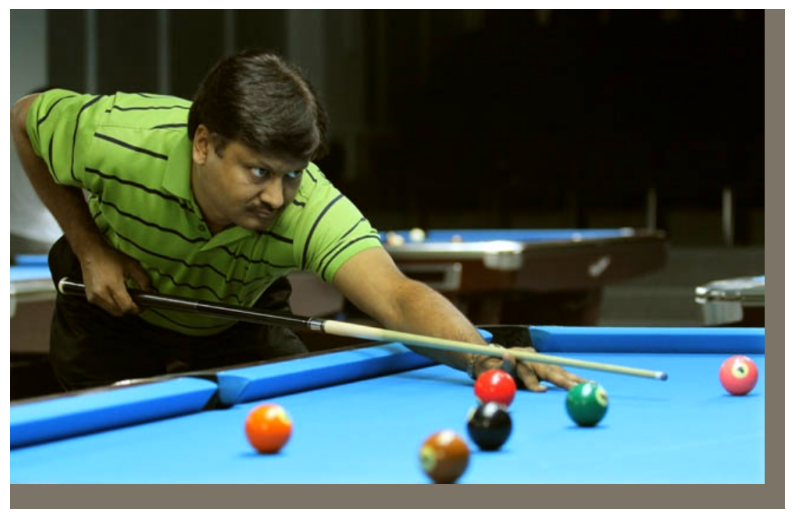

In [ ]:
inv_normalize = transforms.Normalize(
    mean=[-0.485/0.229, -0.456/0.224, -0.406/0.255],
    std=[1/0.229, 1/0.224, 1/0.255]
)

example_transforms = transforms.Compose([
    Normalizer(), Resizer()
])
example_dataset = DetectionDataset(data_dict_file="/content/dl-6-content/oi5_ball_filename_to_bbox_train.json",
                                 transforms=example_transforms, add_path = '/content/dl-6-content/')
iterator = iter(example_dataset)
exp_img = next(iterator)['img']
inv_tensor = inv_normalize(exp_img.permute(2,1,0))
show_image(inv_tensor.permute(2,1,0).numpy())

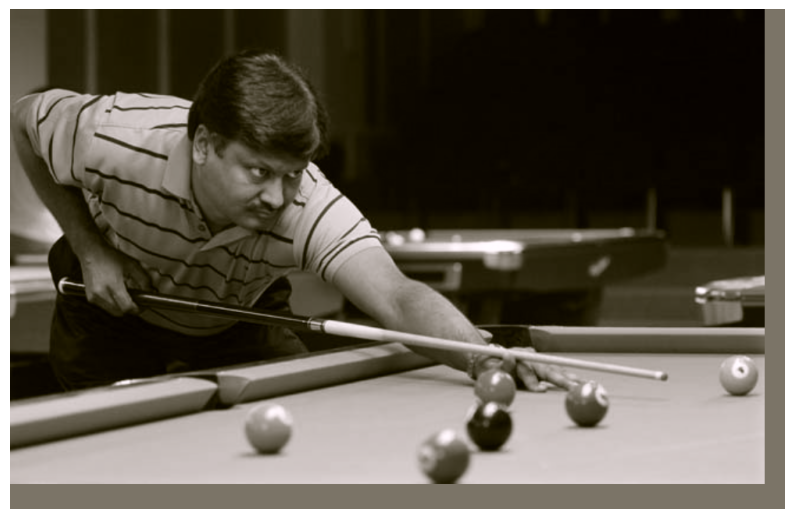

In [ ]:
example_transforms = transforms.Compose([
    Normalizer(), Resizer(), RandomGrayscale()
])
example_dataset = DetectionDataset(data_dict_file="/content/dl-6-content/oi5_ball_filename_to_bbox_train.json",
                                 transforms=example_transforms, add_path = '/content/dl-6-content/')
iterator = iter(example_dataset)
exp_img = next(iterator)['img']
inv_tensor = inv_normalize(exp_img)
show_image(inv_tensor.permute(2,1,0).numpy())

In [ ]:
train_transforms = transforms.Compose([
    Normalizer(), Augmenter(), Resizer()
])

val_transforms = transforms.Compose([
    Normalizer(), Resizer()
])

Теперь к созданию датасетов и даталоадеров.

Обратите внимание на `AspectRatioBasedSampler`:
* Для обучения моделей в `pytorch` необходимо, чтобы все элементы в батче были одного размера.
* Поскольку мы учим полносверточную архитектуру на полных изображениях (а не на кропах, как в классификации), то нам нужно отресайзить их к одному размеру.
Если у изображений разное соотношение сторон, мы будем добавлять рамки (padding).
* `AspectRatioBasedSampler` группирует изображения в датасете таким образом, чтобы в батч попадали изображения с как можно более похожим соотношением сторон, чтобы не делать слишком большие паддинги.

Датасеты устроены так, чтобы возвращать тензор изображения и тензор аннотаций к нему.

In [ ]:
from torch.utils.data.sampler import Sampler

In [ ]:
class AspectRatioBasedSampler(Sampler):
    """Yes, because we'll be creating batches of these images, and since each image has varying sizes, we want to have
    mostly similar images in a batch so that they have to undergo minimal padding to make them the same size
    (we need the same size for all images in a batch because of how anchors are computed)"""
    def __init__(self, data_source, batch_size, drop_last):
        self.data_source = data_source
        self.batch_size = batch_size
        self.drop_last = drop_last
        self.groups = self.group_images()

    def __iter__(self):
        random.shuffle(self.groups)
        for group in self.groups:
            yield group

    def __len__(self):
        if self.drop_last:
            return len(self.data_source) // self.batch_size
        else:
            return (len(self.data_source) + self.batch_size - 1) // self.batch_size

    def group_images(self):
        # determine the order of the images
        order = list(range(len(self.data_source)))
        order.sort(key=lambda x: self.data_source.image_aspect_ratio(x))

        # divide into groups, one group = one batch
        return [[order[x % len(order)] for x in range(i, i + self.batch_size)] for i in range(0, len(order), self.batch_size)]

In [ ]:
def collater(data):
    "Pad data"

    imgs = [s['img'] for s in data]
    annots = [s['annot'] for s in data]
    scales = [s['scale'] for s in data]

    widths = [int(s.shape[0]) for s in imgs]
    heights = [int(s.shape[1]) for s in imgs]
    batch_size = len(imgs)

    # defined max width and height
    max_width = np.array(widths).max()
    max_height = np.array(heights).max()

    # create maximum size image batch filled with zeros
    padded_imgs = torch.zeros(batch_size, max_width, max_height, 3)

    for i in range(batch_size):
        img = imgs[i]
        padded_imgs[i, :int(img.shape[0]), :int(img.shape[1]), :] = img # insert

    max_num_annots = max(annot.shape[0] for annot in annots)

    if max_num_annots > 0:
        # 5 stands for 4 points ([x1, y1, x2, y2]) and a classification class
        annot_padded = torch.ones((len(annots), max_num_annots, 5)) * -1

        if max_num_annots > 0:
            for idx, annot in enumerate(annots):
                #print(annot.shape)
                if annot.shape[0] > 0:
                    annot_padded[idx, :annot.shape[0], :] = annot
    else:
        annot_padded = torch.ones((len(annots), 1, 5)) * -1

    padded_imgs = padded_imgs.permute(0, 3, 1, 2)

    return {'img': padded_imgs, 'annot': annot_padded, 'scale': scales}

In [ ]:
train_dataset = DetectionDataset(data_dict_file="/content/dl-6-content/oi5_ball_filename_to_bbox_train.json",
                                 transforms=train_transforms, add_path = '/content/dl-6-content/')
train_sampler = AspectRatioBasedSampler(train_dataset, batch_size=4, drop_last=False) # deepdive
train_dataloader = DataLoader(train_dataset, num_workers=8, collate_fn=collater, batch_sampler=train_sampler)

val_dataset = DetectionDataset(data_dict_file="/content/dl-6-content/oi5_ball_filename_to_bbox_val.json",
                               transforms=val_transforms, add_path = '/content/dl-6-content/')
val_sampler = AspectRatioBasedSampler(val_dataset, batch_size=4, drop_last=False)
val_dataloader = DataLoader(val_dataset, num_workers=8, collate_fn=collater, batch_sampler=val_sampler)

In [ ]:
item = train_dataset[0]
print(item["img"].size())    # H x W x 3
print(item["annot"].size())  # N x 5; 4 coords + 1 label.

torch.Size([640, 992, 3])
torch.Size([6, 5])


#### 1.4.2 Подготовка к обучению

Во-первых, нужно заменить головы для классификации и регрессии для дообучения.
При этом у классификационной головы нужно указать число классов - 1.

In [ ]:
retinanet.classification_head = ClassificationModel(num_features_in, num_classes=1)
retinanet.regression_head = RegressionModel(num_features_in)
retinanet.to(device)

RetinaNet(
  (backbone): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
       

Во-вторых, потребуется функция для переключения модулей нашей сети в режим обучения; сделаем так, чтобы можно было учить отдельные модули.

**Вопрос**: зачем "замораживать" BN?

In [ ]:
def set_to_training(model, backbone=False, fpn=False, regression_head=True, classification_head=True, freeze_bn=False):
    model.train()
    model.requires_grad_(True)

    if not backbone:
        model.backbone.eval()
        model.backbone.requires_grad_(False)

    elif freeze_bn:
        for layer in model.backbone.modules():
            if isinstance(layer, nn.BatchNorm2d):
                layer.eval()

    if not fpn:
        model.fpn.eval()
        model.fpn.requires_grad_(False)

    if not regression_head:
        model.regression_head.eval()
        model.regression_head.requires_grad_(False)

    if not classification_head:
        model.classification_head.eval()
        model.classification_head.requires_grad_(False)

И простая функция для обучения на 1 эпохе.

In [ ]:
def val_step(model, dataloader):
    model.eval()
    metric_fn = MetricBuilder.build_evaluation_metric("map_2d", async_mode=False, num_classes=1)
    for iter_num, data in tqdm.tqdm(enumerate(dataloader), total=len(dataloader)):
      for img, gt in zip(data['img'], data['annot']):
        with torch.no_grad():
          nms_scores, nms_classes, bboxes = model(img.unsqueeze(0))
        preds = torch.cat([bboxes, nms_classes.unsqueeze(0).T, nms_scores.unsqueeze(0).T], dim = 1).cpu().detach().numpy()
        zeros = torch.zeros((gt.shape[0], 1))
        gt = torch.cat([gt, zeros, zeros], 1).cpu().detach().numpy()
        metric_fn.add(preds, gt)

        del img, gt, preds, zeros, nms_scores, nms_classes, bboxes
      gc.collect()
      torch.cuda.empty_cache()
    print(f"validation mAP in all points: {metric_fn.value(iou_thresholds=0.5)['mAP']}")


def routine(retina_model, scheduler, train_loader, val_loader):
    epoch_loss = []
    torch.cuda.empty_cache()
    for iter_num, data in tqdm.tqdm(enumerate(train_dataloader), total=len(train_dataloader)):

        optimizer.zero_grad()

        classification_loss, regression_loss = retina_model([data['img'].to(device).float(), data['annot'].to(device)])
        classification_loss = classification_loss.mean()
        regression_loss = regression_loss.mean()

        loss = classification_loss + regression_loss

        if bool(loss == 0):
            continue

        loss.backward()
        torch.nn.utils.clip_grad_norm_(retina_model.parameters(), 0.1)
        optimizer.step()

        epoch_loss.append(float(loss.item()))
        del data

    gc.collect()
    torch.cuda.empty_cache()

    print('Epoch: {} | Iteration: {} | Train classification loss: {:1.5f} | train regression loss: {:1.5f} | Epoch loss: {:1.5f}'\
          .format(epoch_num, iter_num, float(classification_loss), float(regression_loss), np.mean(epoch_loss)))
    scheduler.step(np.mean(epoch_loss)) # should be val loss

#### 1.4.3 Обучение

Сначала обучим только новые головы в течение 1 эпохи:

In [ ]:
set_to_training(retinanet, backbone=False, fpn=False, regression_head=True, classification_head=True, freeze_bn=True)

In [ ]:
params = [p for p in retinanet.parameters() if p.requires_grad]
optimizer = torch.optim.Adam(params, lr=3e-4)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience=3, verbose=True)

In [ ]:
import random

In [ ]:
epochs = 1
for epoch_num in range(epochs):
    routine(retinanet, scheduler, train_dataloader, val_dataloader)

100%|██████████| 719/719 [08:54<00:00,  1.35it/s]


Epoch: 0 | Iteration: 718 | Train classification loss: 0.12080 | train regression loss: 0.20011 | Epoch loss: 14.68935


In [ ]:
val_step(retinanet, val_dataloader)

100%|██████████| 57/57 [00:55<00:00,  1.03it/s]

validation mAP in all points: 0.47812196612358093


И потом обучим всю сеть (с "замороженными" BN) - уже подольше.

In [ ]:
set_to_training(retinanet, backbone=True, fpn=True, regression_head=True, classification_head=True, freeze_bn=False)

In [ ]:
params = [p for p in retinanet.parameters() if p.requires_grad]
optimizer = torch.optim.Adam(params, lr=3e-4)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience=3, verbose=True)

In [ ]:
epochs = 10
for epoch_num in range(epochs):
    routine(retinanet, scheduler, train_dataloader, val_dataloader)

    if epoch_num % 10 == 0 or epoch_num + 1 == epochs:
        torch.save(retinanet.state_dict(), f"dev_balls_retinanet_{epoch_num}.pt")

100%|██████████| 719/719 [10:07<00:00,  1.18it/s]
Traceback (most recent call last):
  File "/usr/lib/python3.11/multiprocessing/queues.py", line 239, in _feed
    reader_close()
  File "/usr/lib/python3.11/multiprocessing/connection.py", line 178, in close
    self._close()
  File "/usr/lib/python3.11/multiprocessing/connection.py", line 377, in _close
    _close(self._handle)
OSError: [Errno 9] Bad file descriptor


Epoch: 0 | Iteration: 718 | Train classification loss: 0.70806 | train regression loss: 0.27806 | Epoch loss: 0.84231


100%|██████████| 719/719 [10:08<00:00,  1.18it/s]


Epoch: 1 | Iteration: 718 | Train classification loss: 0.14411 | train regression loss: 0.21657 | Epoch loss: 0.68704


100%|██████████| 719/719 [10:02<00:00,  1.19it/s]


Epoch: 2 | Iteration: 718 | Train classification loss: 0.09901 | train regression loss: 0.27213 | Epoch loss: 0.59216


100%|██████████| 719/719 [10:03<00:00,  1.19it/s]


Epoch: 3 | Iteration: 718 | Train classification loss: 0.38453 | train regression loss: 0.19537 | Epoch loss: 0.54758


100%|██████████| 719/719 [10:01<00:00,  1.19it/s]


Epoch: 4 | Iteration: 718 | Train classification loss: 0.13921 | train regression loss: 0.19975 | Epoch loss: 0.48849


100%|██████████| 719/719 [10:03<00:00,  1.19it/s]


Epoch: 5 | Iteration: 718 | Train classification loss: 0.16578 | train regression loss: 0.17766 | Epoch loss: 0.43742


100%|██████████| 719/719 [10:01<00:00,  1.20it/s]


Epoch: 6 | Iteration: 718 | Train classification loss: 0.17540 | train regression loss: 0.26559 | Epoch loss: 0.41261


100%|██████████| 719/719 [10:01<00:00,  1.20it/s]


Epoch: 7 | Iteration: 718 | Train classification loss: 0.05679 | train regression loss: 0.15813 | Epoch loss: 0.38833


100%|██████████| 719/719 [10:01<00:00,  1.20it/s]


Epoch: 8 | Iteration: 718 | Train classification loss: 0.09647 | train regression loss: 0.23389 | Epoch loss: 0.35024


100%|██████████| 719/719 [10:05<00:00,  1.19it/s]


Epoch: 9 | Iteration: 718 | Train classification loss: 0.20822 | train regression loss: 0.37444 | Epoch loss: 0.32708


In [ ]:
val_step(retinanet, val_dataloader)

100%|██████████| 57/57 [00:53<00:00,  1.06it/s]

validation mAP in all points: 0.41292092204093933


#### 1.4.4 Оценка качества

Для иллюстрации результатов выберем случайные изображения из выборки и отрисуем предсказания.

In [ ]:
with open("/content/dl-6-content/oi5_ball_retinanet_ep=10.pt", "rb") as fp:
    state_dict = torch.load(fp, map_location="cpu")
retinanet.load_state_dict(state_dict)

<All keys matched successfully>

In [ ]:
retinanet.eval();

In [ ]:
val_step(retinanet, val_dataloader)

100%|██████████| 57/57 [00:55<00:00,  1.03it/s]

validation mAP in all points: 0.41292092204093933


torch.Size([1]) tensor([0.8832])
torch.Size([1]) tensor([0])
torch.Size([1, 4]) tensor([[238.6510, 431.4613, 401.8473, 604.2544]])


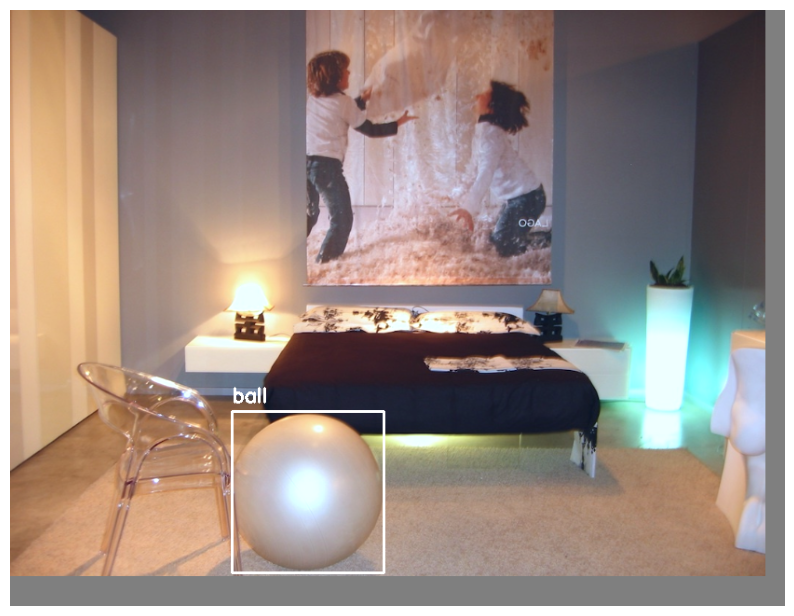

torch.Size([1]) tensor([0.9028])
torch.Size([1]) tensor([0])
torch.Size([1, 4]) tensor([[183.0625,  16.2946, 726.2782, 594.5206]])


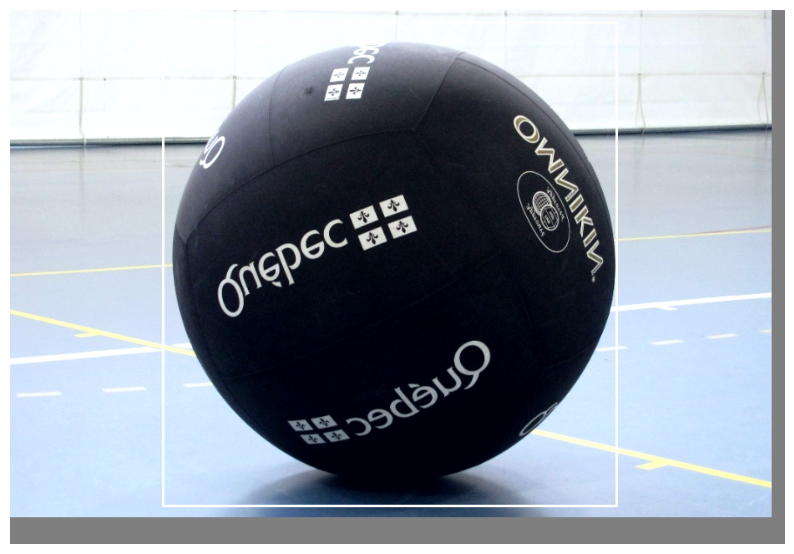

torch.Size([1]) tensor([0.8180])
torch.Size([1]) tensor([0])
torch.Size([1, 4]) tensor([[390.7907, 371.0706, 566.1624, 541.1129]])


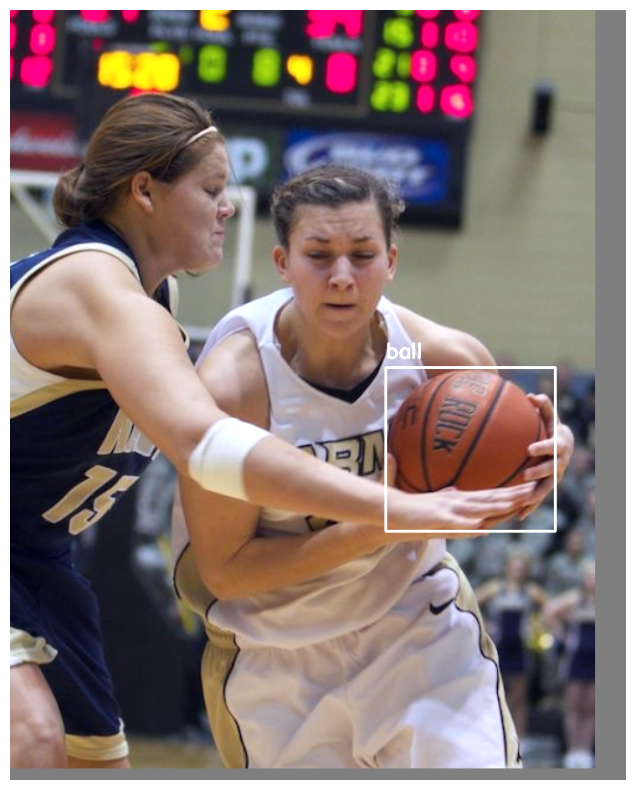

torch.Size([2]) tensor([0.7317, 0.5120])
torch.Size([2]) tensor([0, 0])
torch.Size([2, 4]) tensor([[  0.0000, 495.6164, 102.8433, 608.9238],
        [ 49.3186, 269.0036, 164.4690, 383.7429]])


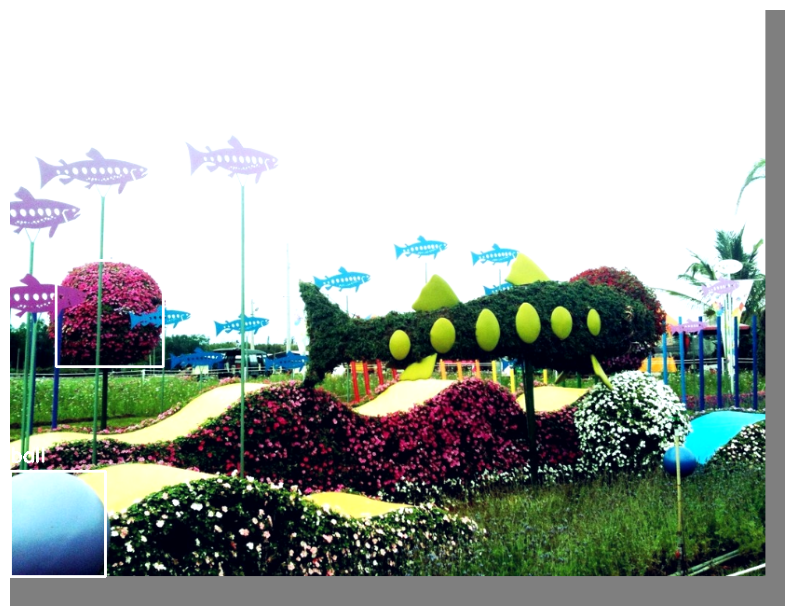

torch.Size([1]) tensor([0.9736])
torch.Size([1]) tensor([0])
torch.Size([1, 4]) tensor([[423.7853, 462.0861, 543.7798, 576.5996]])


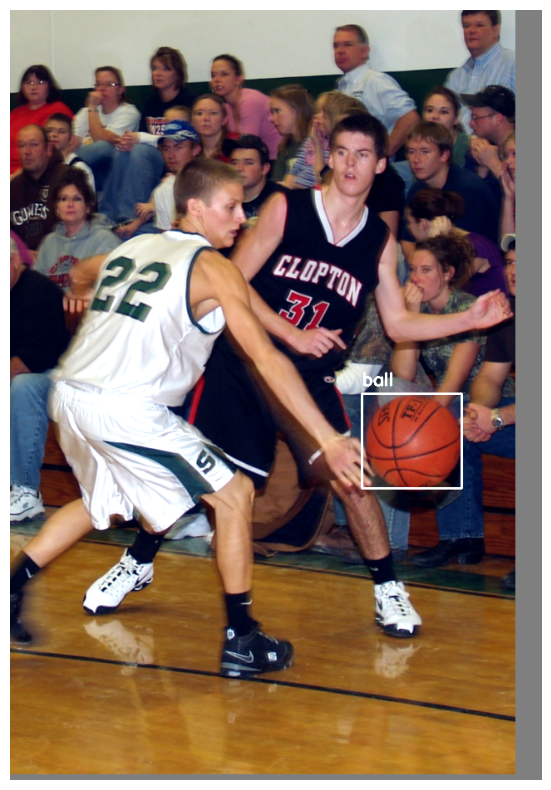

torch.Size([2]) tensor([0.8031, 0.4656])
torch.Size([2]) tensor([0, 0])
torch.Size([2, 4]) tensor([[ 12.5541,  41.3693, 902.4568, 610.7424],
        [  8.7674, 117.1605, 354.7414, 587.5914]])


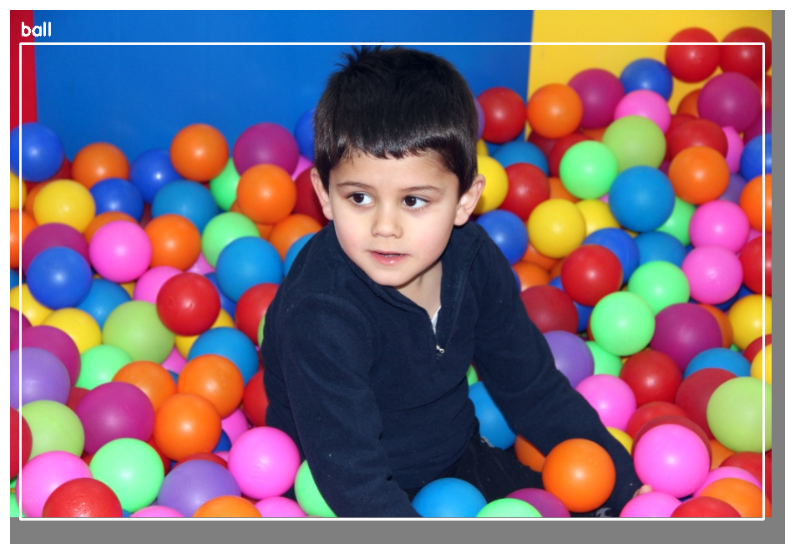

torch.Size([1]) tensor([0.4018])
torch.Size([1]) tensor([0])
torch.Size([1, 4]) tensor([[204.0645, 332.9502, 228.7743, 358.1174]])


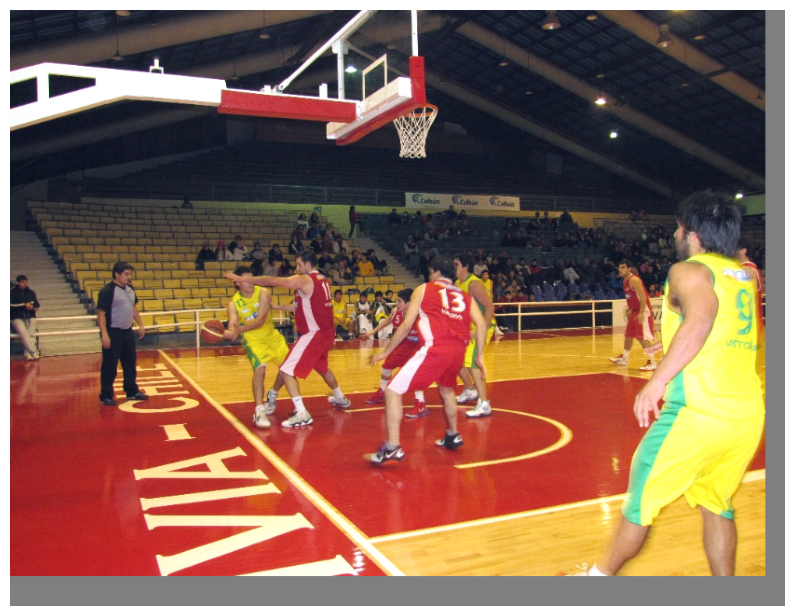

torch.Size([1]) tensor([0.7733])
torch.Size([1]) tensor([0])
torch.Size([1, 4]) tensor([[478.5195,  15.8637, 798.1473, 343.8746]])


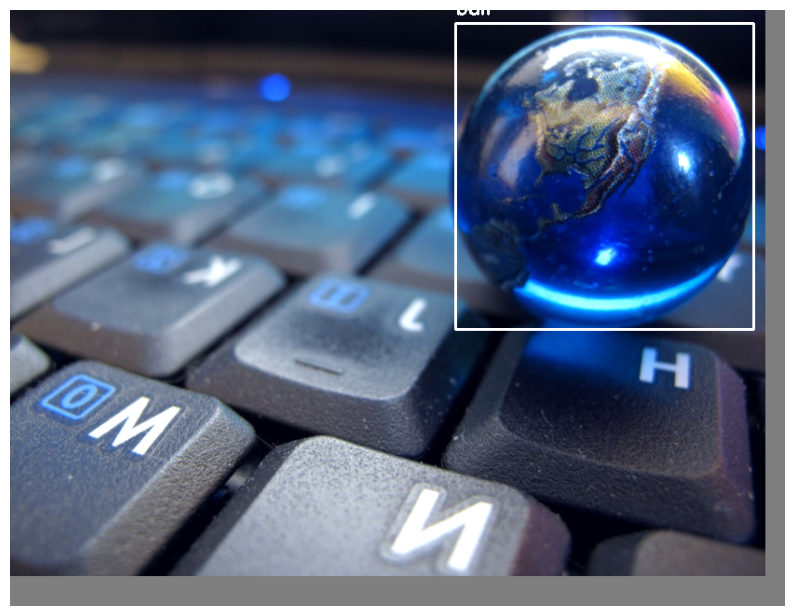

torch.Size([0]) tensor([])
torch.Size([0]) tensor([])
torch.Size([0, 4]) tensor([], size=(0, 4))


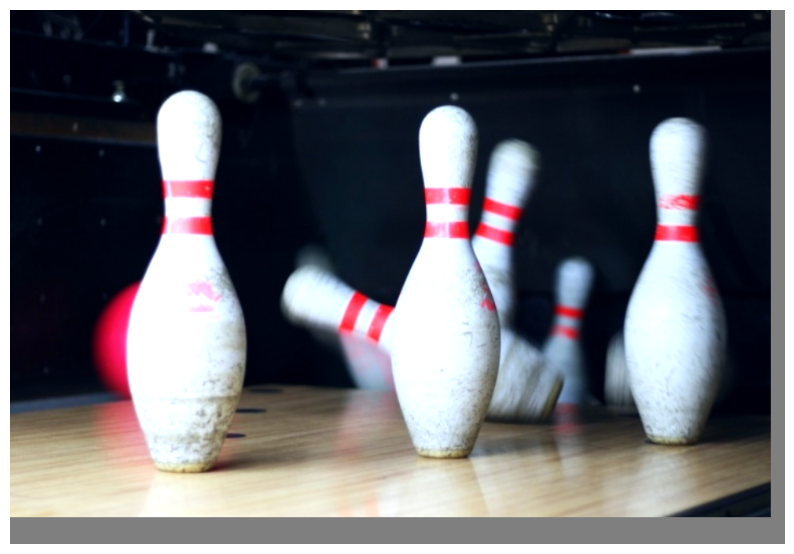

torch.Size([3]) tensor([0.4640, 0.3914, 0.3091])
torch.Size([3]) tensor([0, 0, 0])
torch.Size([3, 4]) tensor([[805.2707, 105.0708, 907.9265, 225.7360],
        [ 53.9223,  97.1227, 224.5047, 290.3937],
        [733.2642,  70.5164, 838.2368, 158.8054]])


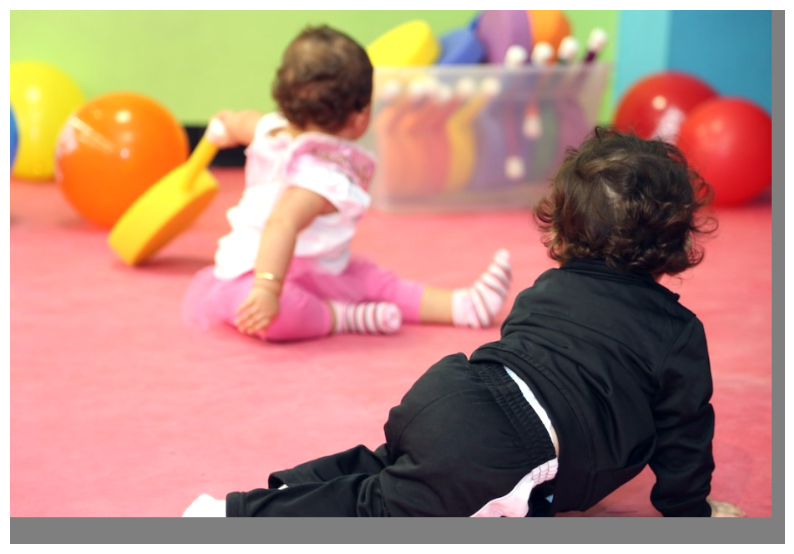

In [ ]:
for i in range(10):
    index = np.random.randint(len(train_dataset))
    tensor = train_dataset[index]["img"].unsqueeze(0)
    run_and_show(retinanet, tensor, 0.5, {0: "ball"}, verbose=True)

Пример из валидации:

torch.Size([2]) tensor([0.4410, 0.4190])
torch.Size([2]) tensor([0, 0])
torch.Size([2, 4]) tensor([[781.5068,   0.0000, 889.9259,  95.7196],
        [735.3686, 303.5858, 807.1528, 369.9500]])


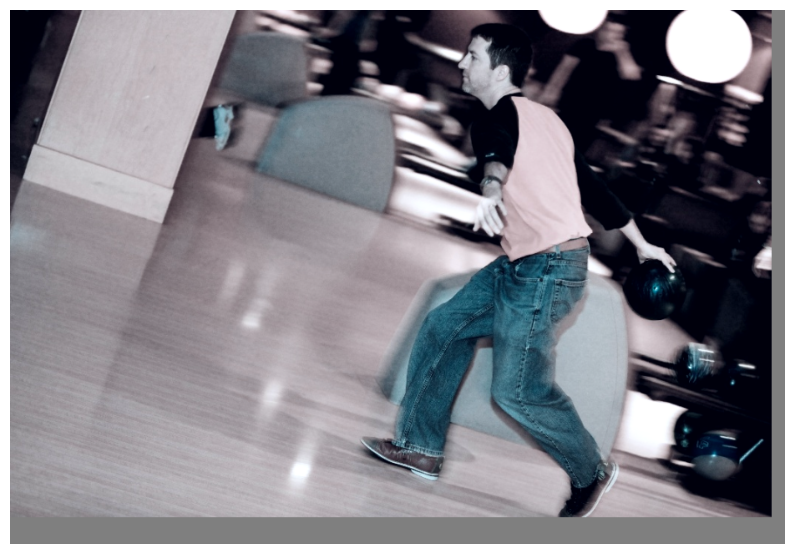

torch.Size([2]) tensor([0.5837, 0.4325])
torch.Size([2]) tensor([0, 0])
torch.Size([2, 4]) tensor([[219.5852, 592.9333, 286.1597, 668.9535],
        [124.9206, 322.0020, 246.7522, 468.7496]])


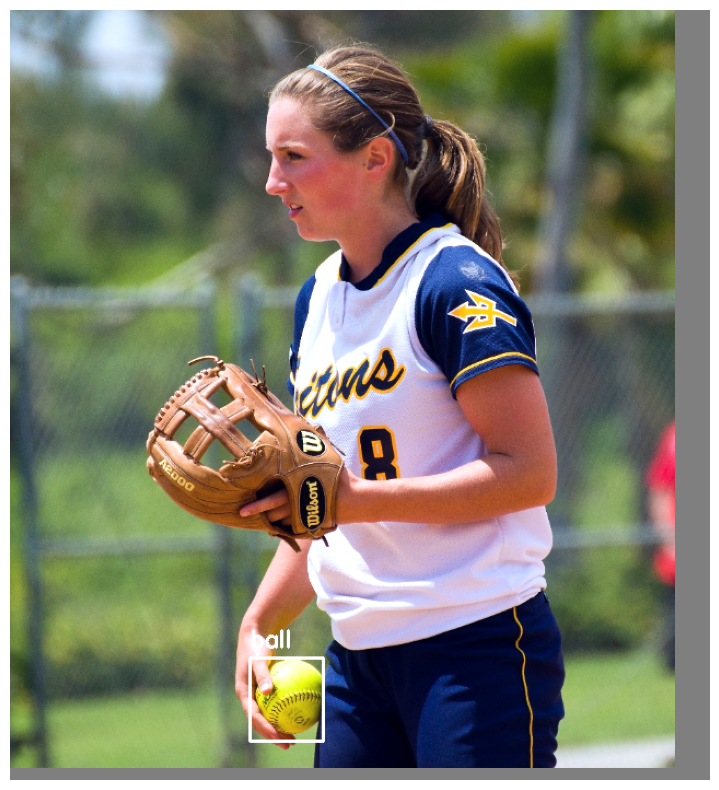

torch.Size([1]) tensor([0.7695])
torch.Size([1]) tensor([0])
torch.Size([1, 4]) tensor([[249.0157, 278.3989, 441.7206, 468.9636]])


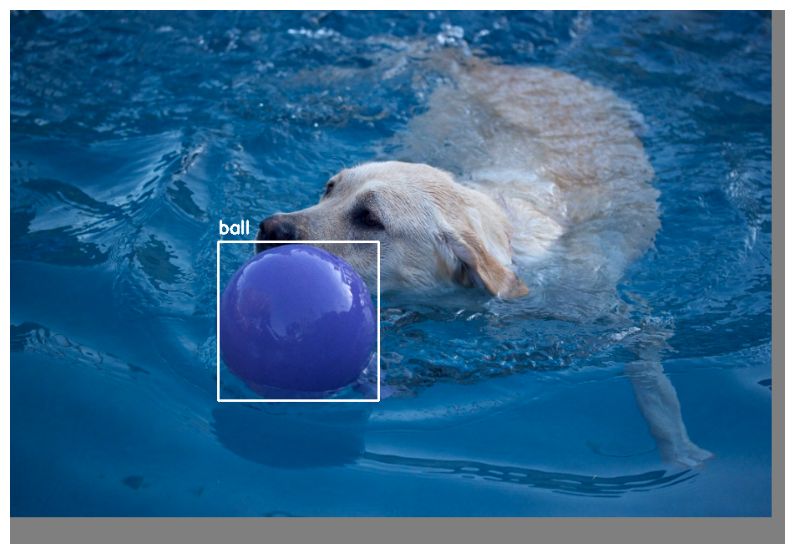

torch.Size([1]) tensor([0.9673])
torch.Size([1]) tensor([0])
torch.Size([1, 4]) tensor([[ 83.7709,  78.2928, 508.7126, 502.7242]])


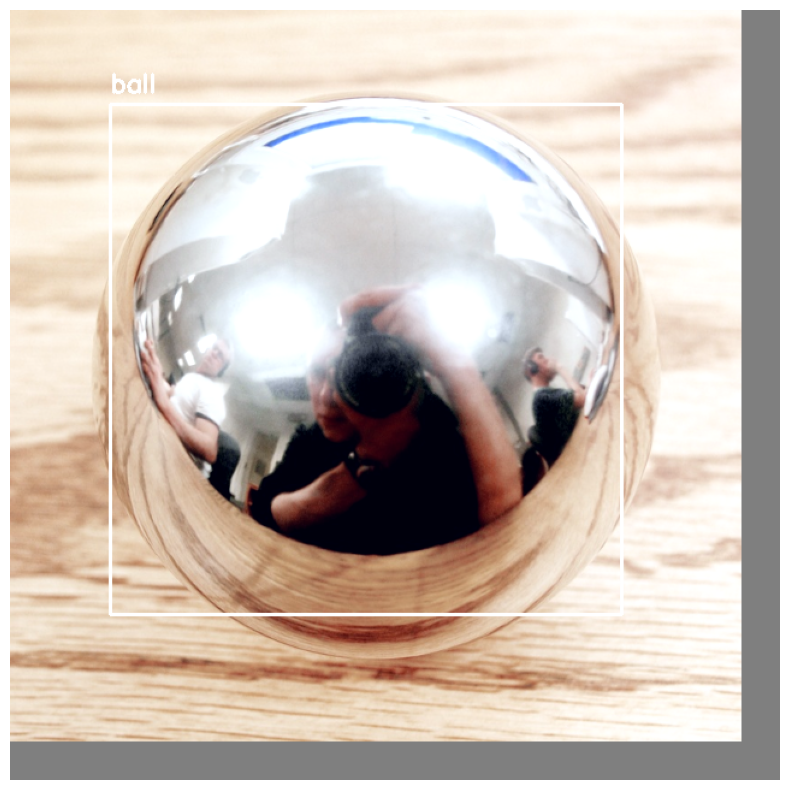

torch.Size([1]) tensor([0.9673])
torch.Size([1]) tensor([0])
torch.Size([1, 4]) tensor([[ 83.7709,  78.2928, 508.7126, 502.7242]])


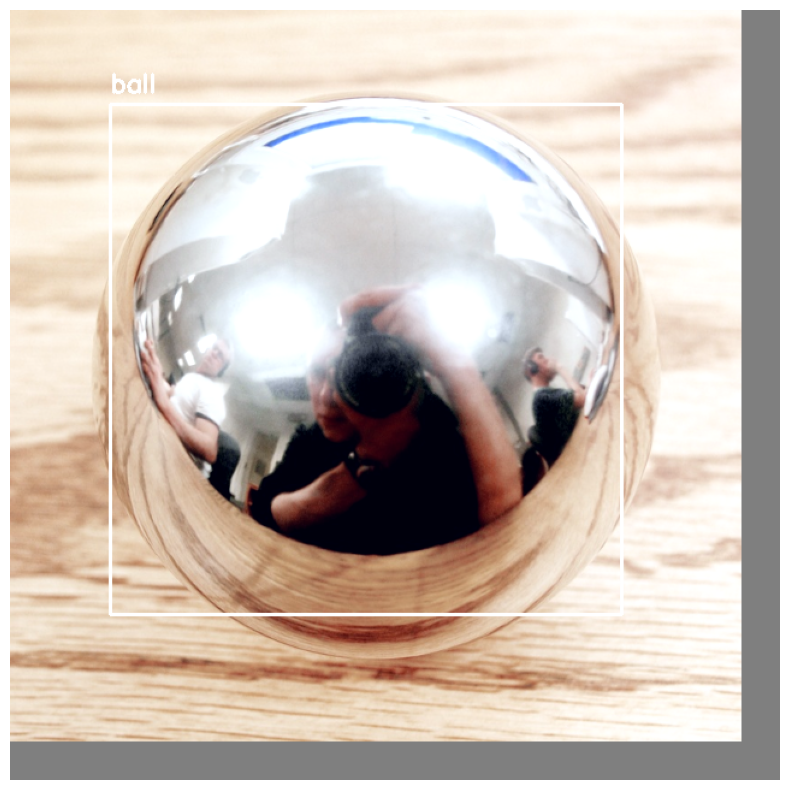

torch.Size([1]) tensor([0.9515])
torch.Size([1]) tensor([0])
torch.Size([1, 4]) tensor([[191.6918,  90.4386, 592.4025, 497.2119]])


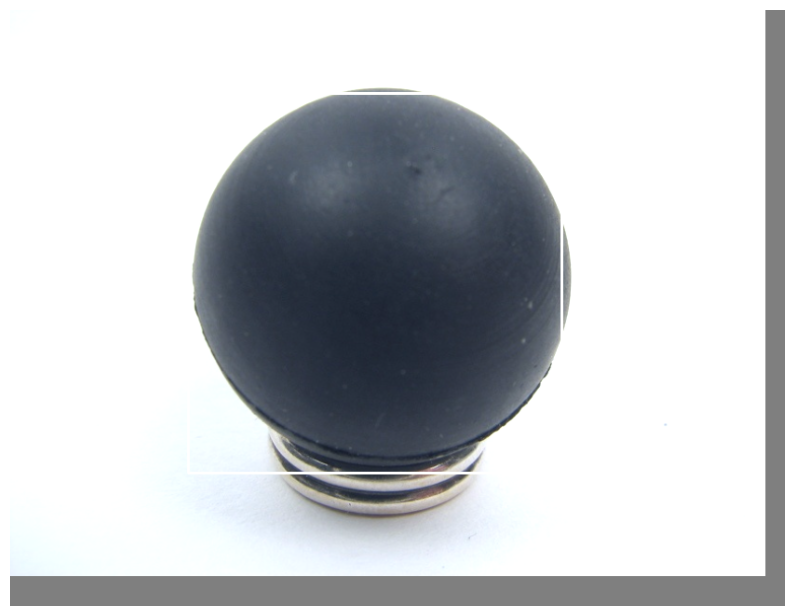

torch.Size([1]) tensor([0.9300])
torch.Size([1]) tensor([0])
torch.Size([1, 4]) tensor([[140.6381, 459.1616, 214.0358, 533.3965]])


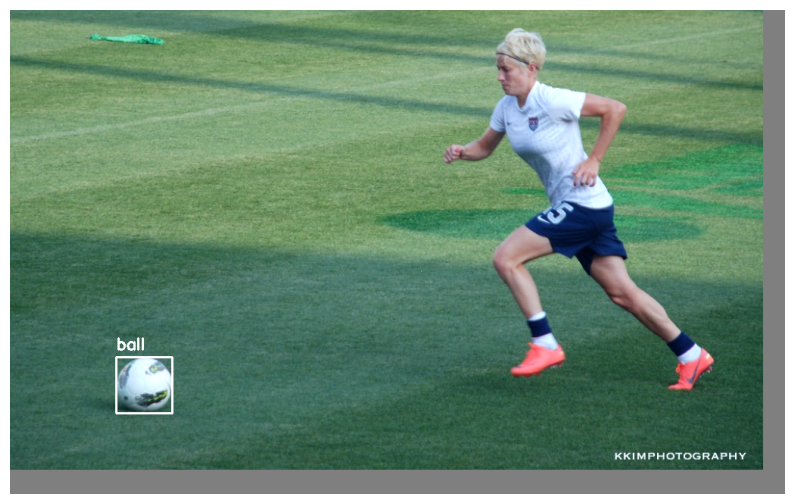

torch.Size([1]) tensor([0.7114])
torch.Size([1]) tensor([0])
torch.Size([1, 4]) tensor([[275.6034, 153.5905, 532.9578, 399.4496]])


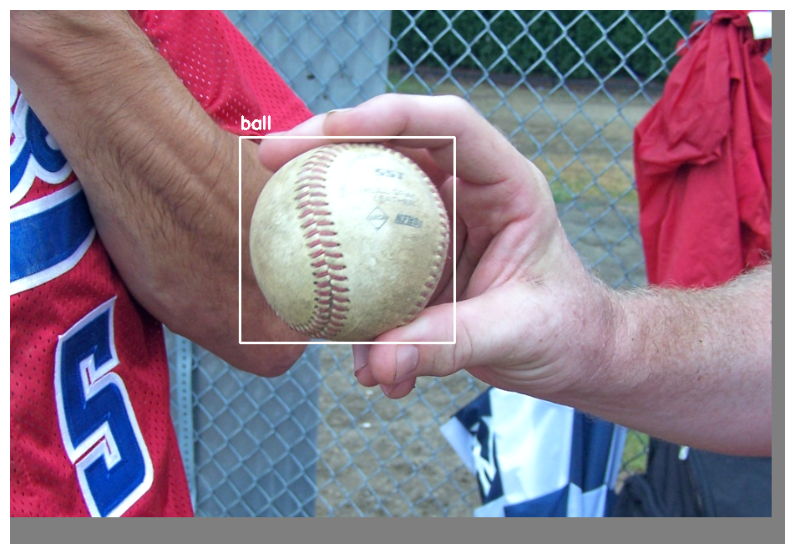

torch.Size([0]) tensor([])
torch.Size([0]) tensor([])
torch.Size([0, 4]) tensor([], size=(0, 4))


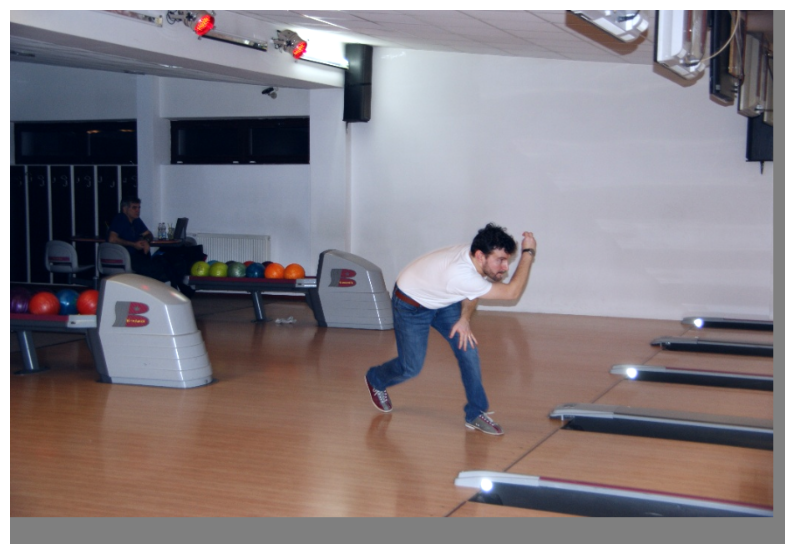

torch.Size([1]) tensor([0.8667])
torch.Size([1]) tensor([0])
torch.Size([1, 4]) tensor([[356.8875,  81.1783, 401.2704, 129.7713]])


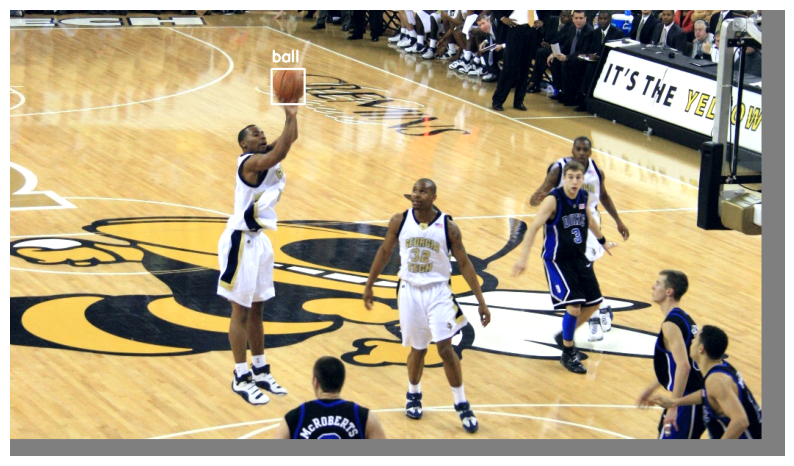

In [ ]:
for i in range(10):
    index = np.random.randint(len(val_dataset))
    tensor = val_dataset[index]["img"].unsqueeze(0)
    run_and_show(retinanet, tensor, 0.5, {0: "ball"}, verbose=True)

---

### 1.5 Резюме

Если бы мы учили детектор для какой-то конкретной задачи, то:

1. Учились бы на нескольких `GPU` (для адекватного размера батча)
2. Более аккуратно подбирали якорные боксы
3. По возможности использовали библиотечные модели (а не кустарные)

## 2. Другая модель (8 баллов)

Решите задачу детекции мячей с помощью другой модели:
1. Загрузите предобученную модель:
  *   https://pytorch.org/vision/stable/models.html
  *   https://paperswithcode.com/sota/object-detection-on-coco

2. Создайте класс датасета и даталоадера
3. Добавьте аугментаций
4. Дообучите несколько эпох
5. Оцените качество
6. Примените модель на вашем изображении *(найти в интернете или загрузить свою картинку, на которой будут мячики)*



# Домашнее задание № 6

Выполните все задания в этом ноутбуке

+ Мягкий дедлайн: `06.03.25 23:59`
+ Жесткий дедлайн: `13.03.25 23:59` (половина баллов)


После жесткого дедлайна задание не принимается.

In [3]:
import os
import json
from PIL import Image
import torch
import torchvision.transforms
import torch.nn as nn
from torch.optim import SGD
from torch.optim.lr_scheduler import StepLR
from torch.utils.data import Dataset, DataLoader
from torchvision.transforms import functional as F
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.rpn import AnchorGenerator
import numpy as np
import albumentations as A
from albumentations.pytorch import ToTensorV2

/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.5 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


In [4]:
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.ops import box_iou
from collections import defaultdict

In [5]:
device = "cuda" if torch.cuda.is_available() else "cpu"
print("Device is:", device)

Device is: cuda


In [8]:
class BallDetectionDataset(Dataset):
    def __init__(self, image_dir, json_file, transform=None):
        self.image_dir = image_dir
        self.transform = transform

        with open(json_file, 'r') as f:
            self.annotations = json.load(f)

        self.image_filenames = list(self.annotations.keys())

    def __len__(self):
        return len(self.image_filenames)

    def __getitem__(self, idx):
        img_name = self.image_filenames[idx]
        img_path = os.path.join(self.image_dir, img_name)

        image = np.array(Image.open(img_path).convert('RGB'))
        height, width = image.shape[:2]

        bboxes = self.annotations[img_name]
        labels = np.ones(len(bboxes))

        bboxes = [
            [bbox[0], bbox[2], bbox[1], bbox[3]]
            for bbox in bboxes
        ]

        bboxes = [
            [xmin * width, ymin * height, xmax * width, ymax * height]
            for xmin, ymin, xmax, ymax in bboxes
        ]

        target = {
            "boxes": bboxes,
            "labels": labels
        }

        if self.transform:
            transformed = self.transform(image=image, bboxes=bboxes, class_labels=labels)
            image = transformed['image']
            bboxes = torch.tensor(transformed['bboxes'], dtype=torch.float32)
            labels = torch.tensor(transformed['class_labels'], dtype=torch.int64)

            target["boxes"] = bboxes
            target["labels"] = labels

        return image, target

In [10]:
train_transform = A.Compose([
    A.Resize(256, 256),
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
    A.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ToTensorV2(),
], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['class_labels']))

In [11]:
val_transform = A.Compose([
    A.Resize(256, 256),
    A.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ToTensorV2(),
], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['class_labels']))

In [12]:
image_dir = '/kaggle/working/dl-6-content/'
train_json_file = '/kaggle/working/dl-6-content/oi5_ball_filename_to_bbox_train.json'
val_json_file = '/kaggle/working/dl-6-content/oi5_ball_filename_to_bbox_val.json'

train_dataset = BallDetectionDataset(image_dir, train_json_file, train_transform)
val_dataset = BallDetectionDataset(image_dir, val_json_file, val_transform)

In [16]:
def collate_fn(batch):
    images = [item[0] for item in batch]
    targets = [item[1] for item in batch]
    
    images = torch.stack(images, dim=0)
    
    return images, targets

In [17]:
train_dataloader = DataLoader(train_dataset, batch_size=4, shuffle=True, num_workers=4, collate_fn=collate_fn)
val_dataloader = DataLoader(val_dataset, batch_size=4, shuffle=False, num_workers=4, collate_fn=collate_fn)

## В качестве модели для обучения будет использоваться Faster RCNN:

In [10]:
def get_model(num_classes=2, pretrained=True):
    backbone = torchvision.models.resnet50(pretrained=pretrained)
    backbone = torch.nn.Sequential(*list(backbone.children())[:-2])
    backbone.out_channels = 2048

    anchor_generator = AnchorGenerator(
        sizes=((32, 64, 128, 256, 512),),
        aspect_ratios=((0.5, 1.0, 2.0),) * 5
    )

    roi_pooler = torchvision.ops.MultiScaleRoIAlign(
        featmap_names=['0'],
        output_size=7,
        sampling_ratio=2
    )

    model = FasterRCNN(
        backbone,
        num_classes=num_classes,
        rpn_anchor_generator=anchor_generator,
        box_roi_pool=roi_pooler
    )

    return model.to(device)

In [16]:
num_classes = 2
model = get_model(num_classes)

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 228MB/s]


In [17]:
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005, momentum=0.9, weight_decay=0.0005)
lr_scheduler = StepLR(optimizer, step_size=3, gamma=0.1)

## Обучение модели (Я не придумал как организовать валидацию, поэтому сохранял модель для каждой эпохи...)

In [18]:
num_epochs = 10
for epoch in range(num_epochs):
    model.train()
    train_loss = 0
    for images, targets in train_dataloader:
        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        train_loss += losses.item()

    train_loss /= len(train_dataloader)
    print(f"Epoch {epoch+1}/{num_epochs}, Training Loss: {train_loss}")

    torch.save({
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict()
        }, f"/kaggle/working/model-epoch-{epoch+1}.pth")

Epoch 1/10, Training Loss: 0.1933401546263562
Epoch 2/10, Training Loss: 0.15089277021576533
Epoch 3/10, Training Loss: 0.13386293915158684
Epoch 4/10, Training Loss: 0.1227657207454942
Epoch 5/10, Training Loss: 0.11178442232196785
Epoch 6/10, Training Loss: 0.10523985734310452
Epoch 7/10, Training Loss: 0.09789575158549739
Epoch 8/10, Training Loss: 0.09187549622845997
Epoch 9/10, Training Loss: 0.08826971167286596
Epoch 10/10, Training Loss: 0.08331647311157245


## Валидация моделей

In [2]:
from torchmetrics.detection import MeanAveragePrecision

In [79]:
results = []

for i in range(10):
    print(f"Evaluating model {i+1}...")
    model_for_eval = get_model(num_classes=2, pretrained=False)
    checkpoint = torch.load(f"/kaggle/working/model-epoch-{i+1}.pth")
    state_dict = checkpoint["model_state_dict"]
    model_for_eval.load_state_dict(state_dict)
    model_for_eval.eval()

    for images, targets in val_dataloader:
        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        with torch.no_grad():
            predictions = model_for_eval(images)

        metric.update(predictions, targets)

    result = metric.compute()
    print(f"Model {i+1} mAP: {result['map']}")
    results.append(result)

Evaluating model 1...
Model 1 mAP: 0.20526105165481567
Evaluating model 2...
Model 2 mAP: 0.19681107997894287
Evaluating model 3...
Model 3 mAP: 0.21032556891441345
Evaluating model 4...
Model 4 mAP: 0.22181497514247894
Evaluating model 5...
Model 5 mAP: 0.23479919135570526
Evaluating model 6...
Model 6 mAP: 0.2446768879890442
Evaluating model 7...
Model 7 mAP: 0.2542390525341034
Evaluating model 8...
Model 8 mAP: 0.25642576813697815
Evaluating model 9...
Model 9 mAP: 0.2613365054130554
Evaluating model 10...
Model 10 mAP: 0.26533305644989014


In [88]:
maps = [result['map'] for result in results]
# God forgive me for what I am about to do...
train_losses = [0.19, 0.15, 0.13, 0.12, 0.11, 0.10, 0.097, 0.091, 0.088, 0.083]

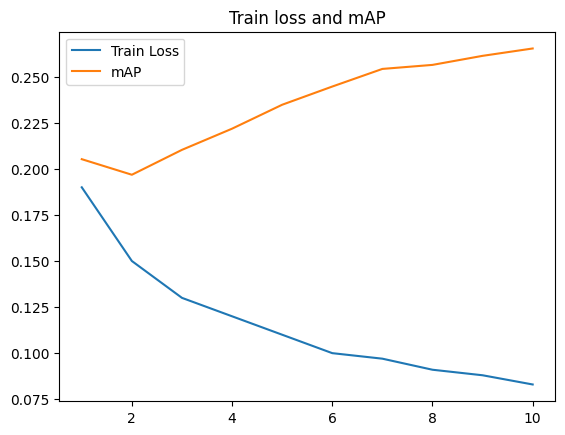

In [99]:
fig, ax = plt.subplots()

ax.plot(range(1, 11), train_losses, label="Train Loss")
ax.plot(range(1, 11), maps, label="mAP")
ax.set_title('Train loss and mAP')

ax.legend()

plt.show()

In [80]:
checkpoint = torch.load("/kaggle/working/model-epoch-10.pth")
state_dict = checkpoint["model_state_dict"]
model = get_model(num_classes=2, pretrained=False)
model.load_state_dict(state_dict)
model.eval()

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (

In [13]:
import matplotlib.pyplot as plt
from torchvision import transforms
from PIL import Image
from matplotlib.patches import Rectangle


def detect_object(image_path: str, model: torchvision.models.detection, confidence=0.5):    
    image = Image.open(image_path).convert("RGB")
    transform = transforms.ToTensor()
    image_tensor = transform(image).unsqueeze(0).to(device)
    
    with torch.no_grad():
        predictions = model(image_tensor)
        
    image_np = image_tensor.squeeze(0).permute(1, 2, 0).cpu().numpy()
    
    fig, ax = plt.subplots(1)
    ax.imshow(image_np)

    for box, label, score in zip(predictions[0]['boxes'], predictions[0]['labels'], predictions[0]['scores']):
        if score > confidence:
            x1, y1, x2, y2 = box.cpu()
            rect = Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=1, edgecolor='r', facecolor='none')
            ax.add_patch(rect)
            ax.text(x1, y1, f'Label: {label}, Score: {score:.2f}', color='r')

    plt.axis("off")        
    plt.show()

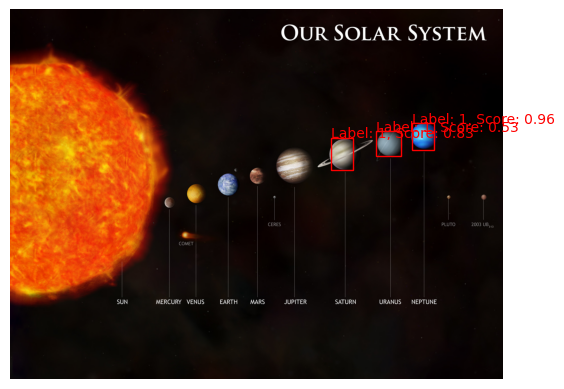

In [82]:
image_path = "/kaggle/input/ball-image/1JkrXruwdFAWsxp_xovHNClybpMtDDzvr-asBbp0DjYYJQDsCYtxG62sdWCf4ZYVaUEKxS8SmUs73WMMlRqG1F7-ngPmvNaBQY6T7wnGEL6zZB8v-bF85H93shKhcCQusEfXjjQNjByR2gs0-d-2310900466.jpg"
detect_object(image_path, model)

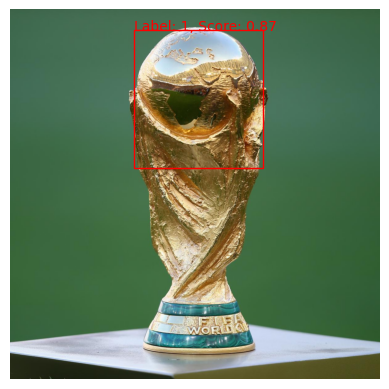

In [83]:
image_path = "/kaggle/input/football/hi-res-6590d5d897933931840ca893be28ab4f_crop_exact-2186567452.jpg"
detect_object(image_path, model)

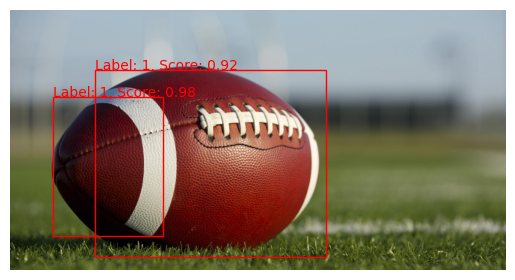

In [84]:
image_path = "/kaggle/input/american-football/football-2451329341.jpg"
detect_object(image_path, model)

# Улучшенный pipeline обучения
## Идея: использвать mAP для валидации модели во время обучения

In [15]:
train_loss_logs = []
map_logs = []

def train(model, optimizer, scheduler, num_epochs, metric, train_dataloader, val_dataloader, patience=5):
    best_map = 0.0
    patience = patience
    epochs_without_improvement = 0 
    
    for epoch in range(num_epochs):
        model.train()
        train_loss = 0
        for images, targets in train_dataloader:
            images = list(image.to(device) for image in images)
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            loss_dict = model(images, targets)
            losses = sum(loss for loss in loss_dict.values())

            optimizer.zero_grad()
            losses.backward()
            optimizer.step()

            train_loss += losses.item()

        model.eval()
        metric.reset()
        for images, targets in val_dataloader:
            images = list(image.to(device) for image in images)
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            with torch.no_grad():
                predictions = model(images)
            
            metric.update(predictions, targets)
            
        val_map = metric.compute()['map'].item()
        train_loss /= len(train_dataloader)
            
        print(f'[Epoch {epoch + 1}/{num_epochs}], Train loss: {train_loss}, Validation mAP: {val_map:.4f}')
        
        train_loss_logs.append(train_loss)
        map_logs.append(val_map)

        if val_map > best_map:
            best_map = val_map
            epochs_without_improvement = 0
            torch.save({
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict()
            }, f"/kaggle/working/faster-rcnn-model.pth")
        else:
            epochs_without_improvement += 1

        if epochs_without_improvement >= patience:
            print(f'Early stopping at epoch {epoch + 1}')
            break

In [16]:
def collate_fn(batch):
    images = [item[0] for item in batch]
    targets = [item[1] for item in batch]
    
    images = torch.stack(images, dim=0)
    
    return images, targets

In [17]:
train_transform = A.Compose([
    A.Resize(256, 256),
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
    A.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ToTensorV2(),
], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['class_labels']))

val_transform = A.Compose([
    A.Resize(256, 256),
    A.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ToTensorV2(),
], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['class_labels']))

In [18]:
BATCH_SIZE = 4
NUM_EPOCHS = 100

image_dir = '/kaggle/working/dl-6-content/'
train_json_file = '/kaggle/working/dl-6-content/oi5_ball_filename_to_bbox_train.json'
val_json_file = '/kaggle/working/dl-6-content/oi5_ball_filename_to_bbox_val.json'

train_dataset = BallDetectionDataset(image_dir, train_json_file, train_transform)
val_dataset = BallDetectionDataset(image_dir, val_json_file, val_transform)

train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4, collate_fn=collate_fn)
val_dataloader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=4, collate_fn=collate_fn)

model = get_model(num_classes=2, pretrained=True)
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005, momentum=0.9, weight_decay=0.0005)
lr_scheduler = StepLR(optimizer, step_size=3, gamma=0.1)
metric = MeanAveragePrecision()

train(
    model=model,
    optimizer=optimizer,
    scheduler=lr_scheduler,
    num_epochs=NUM_EPOCHS,
    metric=metric,
    train_dataloader=train_dataloader,
    val_dataloader=val_dataloader,
    patience=5
)

[Epoch 1/100], Train loss: 0.19407839513537947, Validation mAP: 0.1515
[Epoch 2/100], Train loss: 0.1504324823048002, Validation mAP: 0.2147
[Epoch 3/100], Train loss: 0.13607261355277228, Validation mAP: 0.2652
[Epoch 4/100], Train loss: 0.12055743053835274, Validation mAP: 0.2630
[Epoch 5/100], Train loss: 0.11372731814370782, Validation mAP: 0.3094
[Epoch 6/100], Train loss: 0.10441102460803922, Validation mAP: 0.3058
[Epoch 7/100], Train loss: 0.09818618792019816, Validation mAP: 0.3028
[Epoch 8/100], Train loss: 0.09243790508197396, Validation mAP: 0.3283
[Epoch 9/100], Train loss: 0.08938481632791076, Validation mAP: 0.3311
[Epoch 10/100], Train loss: 0.08623984208141398, Validation mAP: 0.3280
[Epoch 11/100], Train loss: 0.08117485384201639, Validation mAP: 0.3094
[Epoch 12/100], Train loss: 0.07653835458973726, Validation mAP: 0.3322
[Epoch 13/100], Train loss: 0.07201724923546109, Validation mAP: 0.3362
[Epoch 14/100], Train loss: 0.07112787327416997, Validation mAP: 0.3362
[E

### Визуализация зависимости mAP от количества эпох:

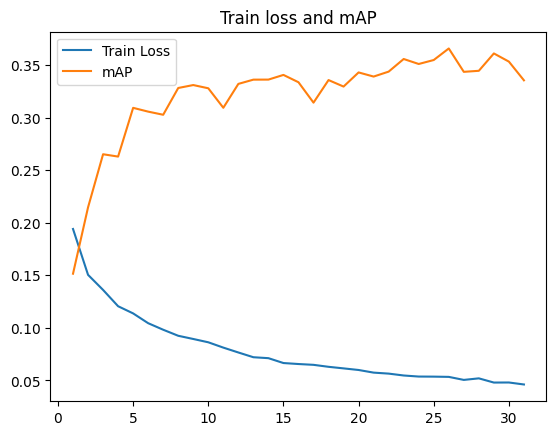

In [19]:
fig, ax = plt.subplots()

ax.plot(range(1, len(train_loss_logs)+1), train_loss_logs, label="Train Loss")
ax.plot(range(1, len(train_loss_logs)+1), map_logs, label="mAP")
ax.set_title('Train loss and mAP')

ax.legend()

plt.show()

### Проверка лучшей получившейся модели:

In [11]:
checkpoint = torch.load("/kaggle/working/faster-rcnn-model.pth")
state_dict = checkpoint["model_state_dict"]
model = get_model(num_classes=2, pretrained=False)
model.load_state_dict(state_dict)
model.eval()

<ipython-input-11-1ce5becc446e>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load("/kaggle/working/faster-rcnn-model.pth")
/usr/local/lib/python3.10/d

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (

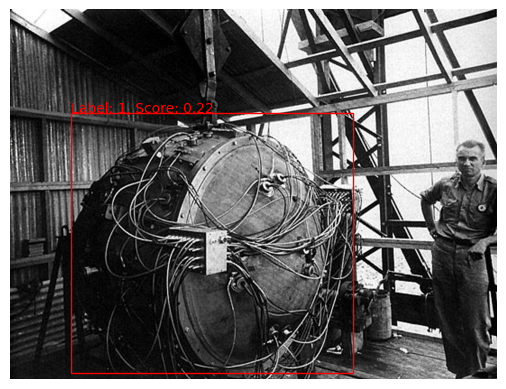

In [31]:
image_path = "/kaggle/input/trinity/trininty_bomb.jpg"
detect_object(image_path, model, confidence=0.1)

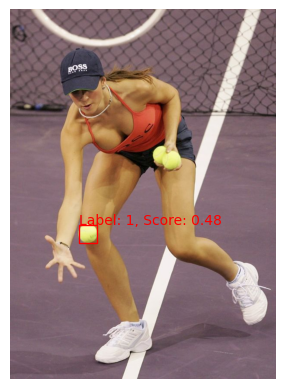

In [1]:
image_path = "/kaggle/input/tennis/0_ATP-Masters-Series-Madrid-3306671709.jpg"
detect_object(image_path, model, confidence=0.1)

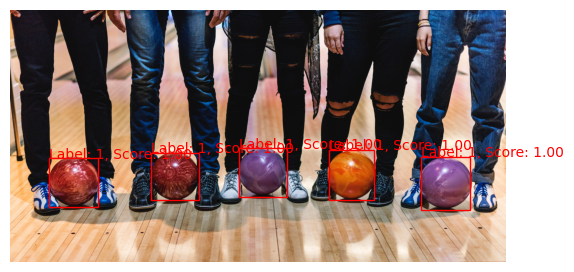

In [44]:
image_path = "/kaggle/input/bowling-image/bowling-bowling-ball-bowling-equipment-ten-pin-bowling-ball-games-individual-sports-bocce-Duckpin-bowling-bowler-ball-game-recreation-sports-sports-equipment-jeans-1536025-293125693.jpg"
detect_object(image_path, model, confidence=0.1)

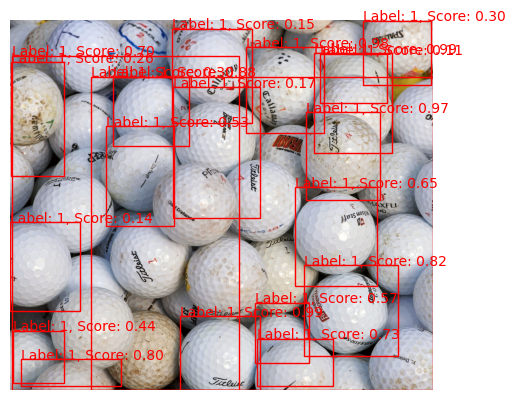

In [13]:
image_path = "/kaggle/input/golf-image/Golf_balls_kallerna.JPG"
detect_object(image_path, model, confidence=0.1)

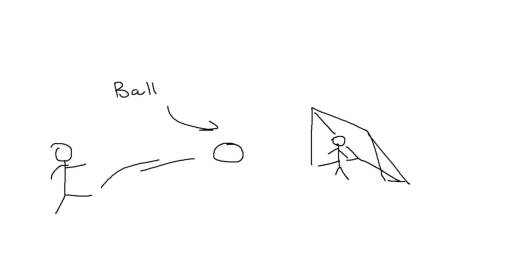

In [2]:
image_path = "/kaggle/input/football-picture/.jpg"
detect_object(image_path, model, confidence=0.0)

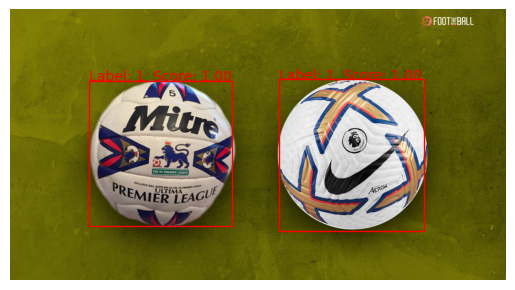

In [9]:
image_path = "/kaggle/input/ball-large-size/PL-MATCH-BALL-HISTORY-646029203.jpg"
detect_object(image_path, model, confidence=0.5)

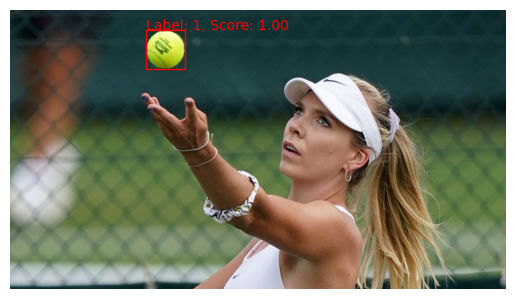

In [11]:
image_path = "/kaggle/input/tennis-images/skysports-tennis-katie-boulter_6204861-828876813.jpg"
detect_object(image_path, model, confidence=0.5)